<a href="https://colab.research.google.com/github/alexanderconroy/Ph.d.-afhandling/blob/main/Religion_sekularisering_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

I denne notebook findes koden, som blev benyttet i afhandlingens del III om religion og sekularisering i det moderne gennembrud.

# Installér om importér biblioteker og pakker

In [ ]:
!pip install sentence-transformers
!pip install bertopic

In [ ]:
from sentence_transformers import SentenceTransformer
from bertopic import BERTopic
from umap import UMAP
from hdbscan import HDBSCAN
from bertopic.representation import KeyBERTInspired
from bertopic.vectorizers import ClassTfidfTransformer
import pandas as pd
import os
import re
from IPython.display import display

from nltk.tokenize import word_tokenize
import nltk
nltk.download('punkt')

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import ticker
from matplotlib import pyplot
sns.set(style='ticks', font_scale=1.2)

import torch
from transformers import AutoModelForSequenceClassification, AutoTokenizer

from google.colab import drive
drive.mount('/content/drive')

# Indlæs data

Her indlæses først metadata, som tilpasses og renses, og dernæst data, dvs. romanerne, og i to omgange for at være i stand til at køre modellerne. Efterfølgende slås resultaterne sammen i en dataframe.

In [ ]:
metadata = pd.read_excel('/content/drive/MyDrive/Notebooks_and_data/MeMo-corpus-metadata-v1.1-2023-06-20.xlsx')
metadata['filename'] = metadata['filename'].str.replace('.pdf', '.paragraphed.txt_ocrfixed.paragraphed.txt')
metadata

In [ ]:
metadata_of_interest = ["filename", "firstname", "surname", "pseudonym", "gender", "nationality", "title", "subtitle", "year", "pages", "typeface", "publisher", "price"]

metadata_df = metadata[metadata_of_interest]

metadata_df

In [ ]:
# Oprydning i metadata
metadata_df = metadata_df.copy()
metadata_df['gender'] = metadata_df['gender'].fillna('ukendt')
metadata_df['nationality'] = metadata_df['nationality'].fillna('ukendt')
metadata_df['price'] = metadata_df['price'].fillna('ukendt')
replacement_dict = {'na': 'ukendt', '(se note)': 'ukendt'}
metadata_df['price'] = metadata_df['price'].replace(replacement_dict)
metadata_df['typeface'] = metadata_df['typeface'].str.strip()
metadata_df['publisher'] = metadata_df['publisher'].str.strip()
metadata_df['nationality'] = metadata_df['nationality'].str.strip()
# Ny kollonne til forfatternavn
metadata_df['author_name'] = (metadata_df['firstname'].str.strip() + ' ' + metadata_df['surname'].str.strip()).str.replace(r'\s+', ' ', regex=True)
# Hvis et forfatternavn ikke er identificeret bruges et evt. pseudonym
metadata_df['author_name'].fillna(metadata_df['pseudonym'], inplace=True)
metadata_df

In [ ]:
dir_path = "/content/drive/MyDrive/Notebooks_and_data/romankorpus.v1.1_w_OCR_error_corrections_paragraphed"

txt_files = [file for file in os.listdir(dir_path) if file.endswith(".txt")]

metadata_filenames = metadata_df['filename'].tolist()

missing_files = [filename for filename in metadata_filenames if filename not in txt_files]

metadata_df = metadata_df[~metadata_df['filename'].isin(missing_files)].reset_index(drop=True)


In [ ]:
# metadata_df.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/metadata_renset_og_tilpasset_korpus.csv')

In [ ]:
dir_path = "/content/drive/MyDrive/Notebooks_and_data/romankorpus.v1.1_w_OCR_error_corrections_paragraphed"

filenames = sorted(os.listdir(dir_path))
len(filenames)

In [ ]:
filenames = [os.path.join(dir_path, filename) for filename in os.listdir(dir_path)
         if filename.endswith(".txt")]
len(filenames)

In [ ]:
big_publishing_houses = ['Gyldendal', 'Det Nordiske Forlag', 'Philipsen', 'Schubothe', 'Schou', 'Reitzel']

In [ ]:
# romaner fra de største forlag
novels_list_1 = metadata_df[metadata_df['publisher'].isin(big_publishing_houses)]['filename'].tolist()
len(novels_list_1)

In [ ]:
# romaner fra de mindre forlag
novels_list_2 = metadata_df[~metadata_df['publisher'].isin(big_publishing_houses)]['filename'].tolist()

In [ ]:
len(novels_list_2)

In [ ]:
novels_from_big_publishers = [os.path.join(dir_path, filename) for filename in novels_list_1]
len(novels_from_big_publishers)

In [ ]:
novels_from_small_publishers = [os.path.join(dir_path, filename) for filename in novels_list_2]
len(novels_from_small_publishers)

# Træn modellerne

Romanerne segmenteres i tekstbidder ud fra afsnit som typografisk markør og op til maksimalt 50 tokens.

For at tage højde for computationelle begrænsninger splittes MeMo-korpusset i to, som hver især behandles med BERTopic. Den første model trænes på romanerne fra de seks største forlag i perioden, mens den anden model trænes på romanerne fra periodens mindre forlag. Resultaterne samles i én dataframe forud for analysen.

Da der anvendes en flersproglig model, præprocesseres romanerne ud fra det, som i den pågældende undersøgelse har vist sig at give anledning til fejl. Specifikt fjernes ord som "Christian" og "Herrer", som embedding-modellen i mange tilfælde fejlagtigt opfatter som religiøse.

Da undersøgelsen er målrettet religion (og sekularisering), anvendes BERTopics seedword-funktion. Denne metode tager udgangspunkt i en liste af nøgleord, som her er 'Gud', 'præst', 'kirke', 'kristen' og 'kristendom'. Vektorer, der ligger tæt på disse nøgleord i embedding-modellens forud etablerede vektorrum, vægtes højere i analysen ved hjælp af en 'seed multiplier', som i dette tilfælde er sat til 2. Dette betyder, at både de valgte ord og ord repræsenteret af nærmeste vektorer i vektorrummet prioriteres, når dokumenter distribueres på topics.


## Romaner fra de største forlag

In [ ]:
max_paragraph_size = 50
docs_titles_1 = []

for filename in novels_from_big_publishers:
    if os.path.isfile(filename):
        try:
            with open(filename, "r", encoding="utf-8") as f:
                year = os.path.split(filename)[-1][:4]
                for line in f:
                    line = line.strip()
                    if not line:
                        continue
                    tokens = line.split()
                    i = 0
                    while i < len(tokens):
                        chunk = tokens[i : i + max_paragraph_size]
                        i += max_paragraph_size
                        doc_title = (" ".join(chunk), os.path.split(filename)[-1], year)
                        docs_titles_1.append(doc_title)
        except FileNotFoundError:
          print(f"File '{filename}' not found.")

In [ ]:
data_1 = {
    "filename_1": [doc_title[1] for doc_title in docs_titles_1],
    "year_1": [doc_title[2] for doc_title in docs_titles_1],
    "docs_1": [doc_title[0] for doc_title in docs_titles_1]
}
df_1 = pd.DataFrame(data_1)
df_1

,filename_1,year_1,docs_1
0,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,I.
1,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,"I den fornemste Gade laae en prægtig, gammelda..."
2,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,"midt i sin Stadsestue, sagtens stille, sone Fr..."
3,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,Den Lille var indtruffen i det rige Huus; der ...
4,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,af Mutter. Ogsaa her stod en Fjerding udenfor ...
...,...,...,...
830823,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890,sin Kæp mod Gulvet.«Og mit røde Hors!... Der e...
830824,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890,"Der var Dage, hvor han hverken vilde spise ell..."
830825,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890,Tilsidst havde han slet ikke Samling paa sine ...
830826,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890,"han var Dreng, og bestandig sad han og mumlede..."


In [ ]:
data_1 = {
    "filename_1": [doc_title[1] for doc_title in docs_titles_1],
    "year_1": [doc_title[2] for doc_title in docs_titles_1],
    "docs_1": [doc_title[0] for doc_title in docs_titles_1]
}
df_1 = pd.DataFrame(data_1)
df_1

,filename_1,year_1,docs_1
0,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,I.
1,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,"I den fornemste Gade laae en prægtig, gammelda..."
2,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,"midt i sin Stadsestue, sagtens stille, sone Fr..."
3,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,Den Lille var indtruffen i det rige Huus; der ...
4,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870,af Mutter. Ogsaa her stod en Fjerding udenfor ...
...,...,...,...
830823,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890,sin Kæp mod Gulvet.«Og mit røde Hors!... Der e...
830824,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890,"Der var Dage, hvor han hverken vilde spise ell..."
830825,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890,Tilsidst havde han slet ikke Samling paa sine ...
830826,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890,"han var Dreng, og bestandig sad han og mumlede..."


In [ ]:
# df_1.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/filename_year_docs_de_store_forlag.csv')

In [ ]:
filename_1 = df_1["filename_1"].to_list()
year_1 = df_1["year_1"].to_list()
docs_1 = df_1["docs_1"].to_list()

print(filename_1[:3])
print(docs_1[:3])
print(year_1[:3])
print(len(docs_1))

['1870_AndersenHC_LykkePeer.paragraphed.txt_ocrfixed.paragraphed.txt', '1870_AndersenHC_LykkePeer.paragraphed.txt_ocrfixed.paragraphed.txt', '1870_AndersenHC_LykkePeer.paragraphed.txt_ocrfixed.paragraphed.txt']
['I.', 'I den fornemste Gade laae en prægtig, gammeldags Gaard; hele Murværket var indæltet med Glasstumper, der i Sal- og Maaneskin straalede som om det var belagt med Diamanter; det var ef Rigdommens Tegn og Rigdom var derinde; man sagde, at Grossereren var Mand for at kunne stille to Tønder Guld', 'midt i sin Stadsestue, sagtens stille, sone Fremtids Sparebøsse, en Fjerding med Guldmynt udenfor Døren, hvor hans lille Søn blev født.']
['1870', '1870', '1870']
830828


In [ ]:
stopwords = ['Herre', 'herre', 'Herren', 'herren','Herrer', 'herrer', 'Herrernes','herrernes','Herrers','herrers', 'Christian', 'Christians', 'Kristian', 'Kristians', 'Kristiane', 'Kristianes']

docs_1 = [' '.join([word for word in word_tokenize(doc) if word not in stopwords]) for doc in docs_1]
print(docs_1[:3])
print(len(docs_1))

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


['I .', 'I den fornemste Gade laae en prægtig , gammeldags Gaard ; hele Murværket var indæltet med Glasstumper , der i Sal- og Maaneskin straalede som om det var belagt med Diamanter ; det var ef Rigdommens Tegn og Rigdom var derinde ; man sagde , at Grossereren var Mand for at kunne stille to Tønder Guld', 'midt i sin Stadsestue , sagtens stille , sone Fremtids Sparebøsse , en Fjerding med Guldmynt udenfor Døren , hvor hans lille Søn blev født .']
830828


In [ ]:
# Kontrol af segmenteringen
display(docs_1[:20])

['I .',
 'I den fornemste Gade laae en prægtig , gammeldags Gaard ; hele Murværket var indæltet med Glasstumper , der i Sal- og Maaneskin straalede som om det var belagt med Diamanter ; det var ef Rigdommens Tegn og Rigdom var derinde ; man sagde , at Grossereren var Mand for at kunne stille to Tønder Guld',
 'midt i sin Stadsestue , sagtens stille , sone Fremtids Sparebøsse , en Fjerding med Guldmynt udenfor Døren , hvor hans lille Søn blev født .',
 'Den Lille var indtruffen i det rige Huus ; der var stor Glæde fra Kjælderen til op paa Qvisfen , dog heroppe blev Glæden endnu større ef Par Timer senere . Pakhuuskarlen og hans Kone boede heroppe og her indtraf netop ogsaa en lille Son , given af Vorherre , bragt af Storken og fremviist',
 'af Mutter . Ogsaa her stod en Fjerding udenfor Døren , ganske tilfældigt , men det var ingen Gnldfjerding , det var en Skarnfjerding .',
 'Den rige Grosserer var en høist veltænkende , brav Mand ; hans Kone , fiin og hoifvrnem gik hun klædt , var gud

**Træn modellen**

In [ ]:
umap_model = UMAP(n_neighbors= 16, min_dist= 0.0, n_components=4, metric='cosine', random_state=1)
hdbscan_model = HDBSCAN(min_cluster_size=25, min_samples=10, metric='euclidean',
                        gen_min_span_tree=True,
                        prediction_data=True)
embedding_model = SentenceTransformer('paraphrase-multilingual-MiniLM-L12-v2')
embedding_model
ctfidf_model = ClassTfidfTransformer(seed_words=["Gud", "præst", "kirke", "kristen", "kristendom"],
    seed_multiplier=2)

representation_model = KeyBERTInspired(random_state=1)

In [ ]:
topic_model_1 = BERTopic(
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    ctfidf_model=ctfidf_model,
    representation_model=representation_model,
    nr_topics='auto',
    calculate_probabilities=False,
    verbose=True
)
topics_1, probs_1 = topic_model_1.fit_transform(docs_1)


**Undersøg output**

In [ ]:
topic_model_1.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,579014,-1_sagde_ikke_stod_han,"[sagde, ikke, stod, han, som, kunde, jo, hans,...","[« Nej , vist gør jeg ej ! Du kan da tro mig p..."
1,0,7127,0_doktorens_lægens_lægen_dokter,"[doktorens, lægens, lægen, dokter, doktoren, d...","[„ Saa lad det staa saa længe , som det kan , ..."
2,1,5817,1_følte_han_tænkte_tanke,"[følte, han, tænkte, tanke, havde, stod, mand,...","[Han , som — træt af Verden — havde tænkt , at..."
3,2,5813,2_følte_følelse_som_stod,"[følte, følelse, som, stod, gik, mig, tænkte, ...","[Jeg bøjede blot mit Hoved ., jeg troede noget..."
4,3,4179,3_gud_guds_sige_tro,"[gud, guds, sige, tro, være, siger, mener, ikk...","[„ Naa , saa Gud hjælpe Dig til at holde det !..."
...,...,...,...,...,...
1136,1135,25,1135_gammelagtige_gamle_ældre_gentleman,"[gammelagtige, gamle, ældre, gentleman, mand, ...",[Og Faderens gamle Venner omringede ham for at...
1137,1136,25,1136_hvorfra_spurgte_sige_hvor,"[hvorfra, spurgte, sige, hvor, satte, fik, du,...","[„ Hvorfra veed Du det ? “, „ Montgolfiere , “..."
1138,1137,25,1137_rige_millionærens_velhavende_han,"[rige, millionærens, velhavende, han, rigere, ...","[„ Men han er jo rig ! “, » Er han rig ? «, » ..."
1139,1138,25,1138_hende_svarede_sagde_han,"[hende, svarede, sagde, han, fruen, forstod, g...","[Hun forstod ham pludselig :, Da forstod hun h..."


**Outlier reduction**

In [ ]:
new_topics_1 = topic_model_1.reduce_outliers(docs_1, topics_1, strategy="c-tf-idf", threshold=0.1)

In [ ]:
topics_updated_ctfidf = topic_model_1
topics_updated_ctfidf.update_topics(docs_1, topics=new_topics_1)

In [ ]:
topics_updated_ctfidf.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,282956,-1_af_den_en_der,"[af, den, en, der, som, og, et, de, med, over]","[« Nej , vist gør jeg ej ! Du kan da tro mig p..."
1,0,7229,0_doktoren_lægen_doktor_læge,"[doktoren, lægen, doktor, læge, doktorens, dr,...","[„ Saa lad det staa saa længe , som det kan , ..."
2,1,5837,1_han_hans_ham_kunde,"[han, hans, ham, kunde, penge, havde, følte, s...","[Han , som — træt af Verden — havde tænkt , at..."
3,2,5894,2_mit_mig_jeg_mine,"[mit, mig, jeg, mine, min, følte, blev, gik, v...","[Jeg bøjede blot mit Hoved ., jeg troede noget..."
4,3,4342,3_gud_guds_dig_du,"[gud, guds, dig, du, mig, vil, jeg, maa, skal,...","[„ Naa , saa Gud hjælpe Dig til at holde det !..."
...,...,...,...,...,...
1136,1135,60,1135_hilste_lykønskede_forbindtligt_vagtfører,"[hilste, lykønskede, forbindtligt, vagtfører, ...",[Og Faderens gamle Venner omringede ham for at...
1137,1136,166,1136_veed_hvorfra_komodeskuffe_faaet,"[veed, hvorfra, komodeskuffe, faaet, komode, t...","[„ Hvorfra veed Du det ? “, „ Montgolfiere , “..."
1138,1137,829,1137_rig_fattig_mand_rige,"[rig, fattig, mand, rige, fornem, uafhængig, m...","[„ Men han er jo rig ! “, » Er han rig ? «, » ..."
1139,1138,342,1138_forstod_anekdote_vidste_nævn,"[forstod, anekdote, vidste, nævn, betød, tilkj...","[Hun forstod ham pludselig :, Da forstod hun h..."


In [ ]:
topics_1 = topics_updated_ctfidf.get_topic_info()

In [ ]:
# topics_1.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SF_topics_med_outlierreduction.csv')

In [ ]:
# gem model
# topics_updated_ctfidf.save("/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SF_topic_model_outlierreduction", serialization="safetensors", save_ctfidf=True, save_embedding_model=embedding_model)

In [ ]:
# indlæs model
# topics_updated_ctfidf = BERTopic.load("/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SF_topic_model_outlierreduction")

2024-03-12 09:39:17,861 - BERTopic - WARNING: You are loading a BERTopic model without explicitly defining an embedding model.If you want to also load in an embedding model, make sure to useBERTopic.load(my_model, embedding_model=my_embedding_model).


In [ ]:
topics_updated_ctfidf.visualize_topics()

In [ ]:
topics_updated_ctfidf.visualize_hierarchy()

In [ ]:
document_info_ctfidf = topics_updated_ctfidf.get_document_info(docs_1)
document_info_ctfidf

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document
0,I .,169,169____,"[, , , , , , , , , ]","[I ., I ., I .]",- - - - - - - - -,0.645186,True
1,"I den fornemste Gade laae en prægtig , gammeld...",-1,-1_af_den_en_der,"[af, den, en, der, som, og, et, de, med, over]","[« Nej , vist gør jeg ej ! Du kan da tro mig p...",af - den - en - der - som - og - et - de - med...,0.000000,False
2,"midt i sin Stadsestue , sagtens stille , sone ...",-1,-1_af_den_en_der,"[af, den, en, der, som, og, et, de, med, over]","[« Nej , vist gør jeg ej ! Du kan da tro mig p...",af - den - en - der - som - og - et - de - med...,0.000000,False
3,Den Lille var indtruffen i det rige Huus ; der...,-1,-1_af_den_en_der,"[af, den, en, der, som, og, et, de, med, over]","[« Nej , vist gør jeg ej ! Du kan da tro mig p...",af - den - en - der - som - og - et - de - med...,0.000000,False
4,af Mutter . Ogsaa her stod en Fjerding udenfor...,-1,-1_af_den_en_der,"[af, den, en, der, som, og, et, de, med, over]","[« Nej , vist gør jeg ej ! Du kan da tro mig p...",af - den - en - der - som - og - et - de - med...,0.000000,False
...,...,...,...,...,...,...,...,...
830823,sin Kæp mod Gulvet. « Og mit røde Hors ! ... D...,-1,-1_af_den_en_der,"[af, den, en, der, som, og, et, de, med, over]","[« Nej , vist gør jeg ej ! Du kan da tro mig p...",af - den - en - der - som - og - et - de - med...,0.000000,False
830824,"Der var Dage , hvor han hverken vilde spise el...",217,217_græd_tårer_græde_grædende,"[græd, tårer, græde, grædende, grædt, hun, taa...","[Hun græd ., Hun græd ., Hun græd .]",græd - tårer - græde - grædende - grædt - hun ...,0.000000,False
830825,Tilsidst havde han slet ikke Samling paa sine ...,39,39_heste_hestene_hesten_vognen,"[heste, hestene, hesten, vognen, vogn, kusken,...","[egen Vogn og Heste ..., Han gik om paa den an...",heste - hestene - hesten - vognen - vogn - kus...,0.000000,False
830826,"han var Dreng , og bestandig sad han og mumled...",-1,-1_af_den_en_der,"[af, den, en, der, som, og, et, de, med, over]","[« Nej , vist gør jeg ej ! Du kan da tro mig p...",af - den - en - der - som - og - et - de - med...,0.000000,False


In [ ]:
df_1.rename(columns={'docs_1': 'Document'}, inplace=True)

In [ ]:
merged_df = pd.merge(document_info_ctfidf, df_1.drop('Document', axis=1), left_index=True, right_index=True, how='inner')

In [ ]:
# merged_df.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SF_documentinfo_OG_FILNAVN_med_outlierreduction.csv')

In [ ]:
selected_topics = [3, 16, 48, 52, 148, 186, 245, 298, 415, 458, 519, 520, 522, 571, 792, 865, 962]
filtered_df = merged_df[document_info_ctfidf['Topic'].isin(selected_topics)]
filtered_df

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document,filename_1,year_1
21,"ham en Psalme og at fremsige „ Fadervor “ , og...",458,458_psalme_salme_psalmer_psalmen,"[psalme, salme, psalmer, psalmen, udenad, sang...","[— Har Du ogsaa en Psalme for , naar Du næste ...",psalme - salme - psalmer - psalmen - udenad - ...,0.000000,False,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870
67,kom de ud ligesom i en stor Kirke med Pulpitur...,415,415_kirke_kirken_søndag_hellige,"[kirke, kirken, søndag, hellige, sanct, søndag...","[Kirke ., » I Kirke ! «, Kirke .]",kirke - kirken - søndag - hellige - sanct - sø...,0.000000,False,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870
118,„ Har Du Stemme ? “ spurgte Capelmesteren og s...,16,16_præst_præsten_pastor_pastoren,"[præst, præsten, pastor, pastoren, kirken, kir...","[» Var Deres Fader Præst ? «, „ Jeg er Præst. ...",præst - præsten - pastor - pastoren - kirken -...,0.992623,False,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870
139,"sang og jubilerede han , de behøvede saamænd i...",458,458_psalme_salme_psalmer_psalmen,"[psalme, salme, psalmer, psalmen, udenad, sang...","[— Har Du ogsaa en Psalme for , naar Du næste ...",psalme - salme - psalmer - psalmen - udenad - ...,0.000000,False,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870
169,— „ Det har jeg aldrig hørt ! sagde jeg . Har ...,3,3_gud_guds_dig_du,"[gud, guds, dig, du, mig, vil, jeg, maa, skal,...","[„ Naa , saa Gud hjælpe Dig til at holde det !...",gud - guds - dig - du - mig - vil - jeg - maa ...,1.000000,False,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,1870
...,...,...,...,...,...,...,...,...,...,...
830162,Hun vendte langsomt Øjnene om imod mig til et ...,52,52_gud_hun_vil_guds,"[gud, hun, vil, guds, du, kan, mig, satan, dig...","[« Aa — Gud , aa — Gud ! » sukkede hun ., » De...",gud - hun - vil - guds - du - kan - mig - sata...,0.960980,False,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890
830299,"« Ja , saadan sa ’ e han . »",3,3_gud_guds_dig_du,"[gud, guds, dig, du, mig, vil, jeg, maa, skal,...","[„ Naa , saa Gud hjælpe Dig til at holde det !...",gud - guds - dig - du - mig - vil - jeg - maa ...,0.951337,False,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890
830394,"« Jeg ? ... Jo , Død og Pine , jeg er saa ra >...",3,3_gud_guds_dig_du,"[gud, guds, dig, du, mig, vil, jeg, maa, skal,...","[„ Naa , saa Gud hjælpe Dig til at holde det !...",gud - guds - dig - du - mig - vil - jeg - maa ...,0.965339,False,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890
830450,"﻿ « Ja , vær nu flink , Andreas ... fortæl nu ...",3,3_gud_guds_dig_du,"[gud, guds, dig, du, mig, vil, jeg, maa, skal,...","[„ Naa , saa Gud hjælpe Dig til at holde det !...",gud - guds - dig - du - mig - vil - jeg - maa ...,0.959927,False,1890_Pontoppidan_Natur.paragraphed.txt_ocrfixe...,1890


## Romaner fra de mindre forlag

In [ ]:
max_paragraph_size = 50
docs_titles_2 = []

for filename in novels_from_small_publishers:
    if os.path.isfile(filename):
        try:
            with open(filename, "r", encoding="utf-8") as f:
                year = os.path.split(filename)[-1][:4]
                for line in f:
                    line = line.strip()
                    if not line:
                        continue
                    tokens = line.split()
                    i = 0
                    while i < len(tokens):
                        chunk = tokens[i : i + max_paragraph_size]
                        i += max_paragraph_size
                        doc_title = (" ".join(chunk), os.path.split(filename)[-1], year)
                        docs_titles_2.append(doc_title)
        except FileNotFoundError:
          print(f"File '{filename}' not found.")

In [ ]:
data_2 = {
    "filename_2": [doc_title[1] for doc_title in docs_titles_2],
    "year_2": [doc_title[2] for doc_title in docs_titles_2],
    "docs_2": [doc_title[0] for doc_title in docs_titles_2]
}
df_2 = pd.DataFrame(data_2)
df_2

,filename_2,year_2,docs_2
0,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870,I.
1,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870,Hvorfor Ridder Casper ikke fik en Synder hængt...
2,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870,"Sankt Dionysii Dag, efter Christi Byrd 1522, s..."
3,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870,"Slemmedegn ligger begraven, lidt derfra laa Gr..."
4,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870,"paa Slottet, det gamle Aalbørghus, som graat a..."
...,...,...,...
1101210,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899,Herefter kom der en travl Tid i Hostrups Hus m...
1101211,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899,"Endelig var alt færdigt, og sex Uger efter sto..."
1101212,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899,Samme Dag og i samme Kirke viedes ogsaa et and...
1101213,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899,"etablerede en Forretning, der sikrede ham et r..."


In [ ]:
# df_2.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/filename_year_docs_små_forlag.csv')

In [ ]:
filename_2 = df_2["filename_2"].to_list()
year_2 = df_2["year_2"].to_list()
docs_2 = df_2["docs_2"].to_list()

print(filename_2[:3])
print(docs_2[:3])
print(year_2[:3])
print(len(docs_2))

['1870_Brosboell_TranensVarsel.paragraphed.txt_ocrfixed.paragraphed.txt', '1870_Brosboell_TranensVarsel.paragraphed.txt_ocrfixed.paragraphed.txt', '1870_Brosboell_TranensVarsel.paragraphed.txt_ocrfixed.paragraphed.txt']
['I.', 'Hvorfor Ridder Casper ikke fik en Synder hængt i Aalborg Galge.', 'Sankt Dionysii Dag, efter Christi Byrd 1522, skinnede Efteraarssølen ned øver Aalborg By, spejlede sig i Fjorden og kastede et rødligt Lys hen over Kirkerne og Klostrene, som hævede deres Taarne og Stentage øp over Borgernes smaa og straataklc Huse. Mod Øst saae man Sankta Marias gamle Kirke, hvori Sigurd']
['1870', '1870', '1870']
1101215


In [ ]:
stopwords = ['Herre', 'herre', 'Herren', 'herren','Herrer', 'herrer', 'Herrernes','herrernes','Herrers','herrers', 'Christian', 'Christians', 'Kristian', 'Kristians', 'Kristiane', 'Kristianes']

docs_2 = [' '.join([word for word in word_tokenize(doc) if word not in stopwords]) for doc in docs_2]
print(docs_2[:3])
print(len(docs_2))

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


['I .', 'Hvorfor Ridder Casper ikke fik en Synder hængt i Aalborg Galge .', 'Sankt Dionysii Dag , efter Christi Byrd 1522 , skinnede Efteraarssølen ned øver Aalborg By , spejlede sig i Fjorden og kastede et rødligt Lys hen over Kirkerne og Klostrene , som hævede deres Taarne og Stentage øp over Borgernes smaa og straataklc Huse . Mod Øst saae man Sankta Marias gamle Kirke , hvori Sigurd']
1101215


In [ ]:
# Kontrol af segmenteringen
display(docs_2[:20])

['I .',
 'Hvorfor Ridder Casper ikke fik en Synder hængt i Aalborg Galge .',
 'Sankt Dionysii Dag , efter Christi Byrd 1522 , skinnede Efteraarssølen ned øver Aalborg By , spejlede sig i Fjorden og kastede et rødligt Lys hen over Kirkerne og Klostrene , som hævede deres Taarne og Stentage øp over Borgernes smaa og straataklc Huse . Mod Øst saae man Sankta Marias gamle Kirke , hvori Sigurd',
 'Slemmedegn ligger begraven , lidt derfra laa Graabrødrekloster og midt for Algaden Sankt Budolfs støre Kirke , som Aaret iforveien havde faaet sig to nye Klokker . Længer mod Vest laa Helligaandsklostret , og lidt udenfor Byen , som dengang endte ved Besteraa , laa Sankt Pederskirke . Alle syntes de mægtige og overmodige at stirre ned',
 'paa Slottet , det gamle Aalbørghus , som graat af Ælde , forfaldent og ødelagt , reiste sig mod Sønder , omkredset af udtørrede , græsbegroede Voldgrave , hvoraf en tjente til Reberbane , medens Borgerkonerne havde reist store Stilladser til at blege deres spundn

**Træn modellen**

In [ ]:
umap_model = UMAP(n_neighbors= 15, min_dist= 0.0, n_components=4, metric='cosine', random_state=1)
hdbscan_model = HDBSCAN(min_cluster_size=40, min_samples=10, metric='euclidean',
                        gen_min_span_tree=True,
                        prediction_data=True)
embedding_model = SentenceTransformer('paraphrase-multilingual-MiniLM-L12-v2')
embedding_model
ctfidf_model = ClassTfidfTransformer(seed_words=["Gud", "præst", "kirke", "kristen", "kristendom"],
    seed_multiplier=2)
representation_model = KeyBERTInspired(random_state=1)

In [ ]:
topic_model_2 = BERTopic(
    embedding_model=embedding_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    ctfidf_model=ctfidf_model,
    representation_model=representation_model,
    nr_topics='auto',
    calculate_probabilities=False,
    verbose=True
)
topics_2, probs_2 = topic_model_2.fit_transform(docs_2)

**Undersøg output**

In [ ]:
topic_model_2.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,683261,-1_sagde_stod_kom_som,"[sagde, stod, kom, som, hende, hendes, gik, ik...","[blev hvor hun var , medens hun var meget vred..."
1,0,19013,0_hende_her_hendes_sagde,"[hende, her, hendes, sagde, kvinde, svarede, s...","[Men saa sagde hun :, —• — — Og hun ?, til hen..."
2,1,10882,1_faderen_papa_søns_sønnen,"[faderen, papa, søns, sønnen, fader, søn, onke...","[„ Men det er jo ikke Deres Fader. “, „ Dog ik..."
3,2,10628,2_kongen_konge_konges_fyrsten,"[kongen, konge, konges, fyrsten, fyrste, konge...","[— Kongen kommer !, „ Kongen ! “, „ Kongen ! “]"
4,3,7716,3_imidlertid_han_tidligere_havde,"[imidlertid, han, tidligere, havde, følte, sto...",[Denne Aften lagde han sig ret vel tilmode til...
...,...,...,...,...,...
1092,1091,40,1091_odense_españa_viva_hædrede,"[odense, españa, viva, hædrede, hujende, avror...","[var i Odense. “, „ Til Odense ! “, „ I Odense..."
1093,1092,40,1092_stilheden_stilhed_tyst_tavshed,"[stilheden, stilhed, tyst, tavshed, stille, væ...","[Der blev stille i Værelset ., Nogle Øjeblikke..."
1094,1093,40,1093_longberg_longomontanus_longomonfanus_llon...,"[longberg, longomontanus, longomonfanus, llona...","[„ Ak , er det muligt ? “ udbrød Longomontanus..."
1095,1094,40,1094_tang_tangemanners_tangemanns_tangemann,"[tang, tangemanners, tangemanns, tangemann, al...","[Pludselig opdagede han Tang ., Greven vendte ..."


**Outlier reduction**

In [ ]:
new_topics_2 = topic_model_2.reduce_outliers(docs_2, topics_2, strategy="c-tf-idf", threshold=0.1)

In [ ]:
topics_updated_ctfidf = topic_model_2
topics_updated_ctfidf.update_topics(docs_2, topics=new_topics_2)

In [ ]:
topics_updated_ctfidf.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,298538,-1_af_der_den_som,"[af, der, den, som, en, og, de, var, over, med]","[blev hvor hun var , medens hun var meget vred..."
1,0,19062,0_hende_hun_mig_jeg,"[hende, hun, mig, jeg, du, vil, dig, hendes, h...","[Men saa sagde hun :, —• — — Og hun ?, til hen..."
2,1,11170,1_fader_søn_barn_din,"[fader, søn, barn, din, børn, min, broder, dre...","[„ Men det er jo ikke Deres Fader. “, „ Dog ik..."
3,2,10996,2_kongen_eder_majestæt_eders,"[kongen, eder, majestæt, eders, kongens, konge...","[— Kongen kommer !, „ Kongen ! “, „ Kongen ! “]"
4,3,7776,3_han_penge_hans_ham,"[han, penge, hans, ham, kunde, maade, havde, t...",[Denne Aften lagde han sig ret vel tilmode til...
...,...,...,...,...,...
1092,1091,281,1091_odense_æresborger_fødeby_barndomshjem,"[odense, æresborger, fødeby, barndomshjem, hel...","[var i Odense. “, „ Til Odense ! “, „ I Odense..."
1093,1092,272,1092_stilhed_herskede_tyst_værelset,"[stilhed, herskede, tyst, værelset, dyb, lydlø...","[Der blev stille i Værelset ., Nogle Øjeblikke..."
1094,1093,156,1093_longomontanus_longomontanns_tyge_prag,"[longomontanus, longomontanns, tyge, prag, thg...","[„ Ak , er det muligt ? “ udbrød Longomontanus..."
1095,1094,230,1094_tang_tangemann_erna_slægten,"[tang, tangemann, erna, slægten, bruno, stedin...","[Pludselig opdagede han Tang ., Greven vendte ..."


In [ ]:
topics_2 = topics_updated_ctfidf.get_topic_info()

In [ ]:
# topics_2.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SmF_topics_med_outlierreduction.csv')

In [ ]:
# topics_updated_ctfidf.save("/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/de_små_forlag_outlierreduction", serialization="safetensors", save_ctfidf=True, save_embedding_model=embedding_model)

In [ ]:
topics_updated_ctfidf.visualize_topics()

In [ ]:
topics_updated_ctfidf.visualize_hierarchy()

In [ ]:
document_info_ctfidf = topics_updated_ctfidf.get_document_info(docs_2)

In [ ]:
df_2.rename(columns={'docs_2': 'Document'}, inplace=True)

In [ ]:
merged_df = pd.merge(document_info_ctfidf, df_2.drop('Document', axis=1), left_index=True, right_index=True, how='inner')

In [ ]:
merged_df

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document,filename_2,year_2
0,I .,142,142_ii_iv_hvorhen_ende,"[ii, iv, hvorhen, ende, del, jonskirken, først...","[II ., II ., II .]",ii - iv - hvorhen - ende - del - jonskirken - ...,0.994740,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
1,Hvorfor Ridder Casper ikke fik en Synder hængt...,-1,-1_af_der_den_som,"[af, der, den, som, en, og, de, var, over, med]","[blev hvor hun var , medens hun var meget vred...",af - der - den - som - en - og - de - var - ov...,0.000000,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
2,"Sankt Dionysii Dag , efter Christi Byrd 1522 ,...",261,261_kirke_kirken_frue_kirkens,"[kirke, kirken, frue, kirkens, søndag, kapel, ...","[til min fattige Kirke. “, „ Hvilken kirke ? “...",kirke - kirken - frue - kirkens - søndag - kap...,0.000000,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
3,"Slemmedegn ligger begraven , lidt derfra laa G...",261,261_kirke_kirken_frue_kirkens,"[kirke, kirken, frue, kirkens, søndag, kapel, ...","[til min fattige Kirke. “, „ Hvilken kirke ? “...",kirke - kirken - frue - kirkens - søndag - kap...,0.000000,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
4,"paa Slottet , det gamle Aalbørghus , som graat...",-1,-1_af_der_den_som,"[af, der, den, som, en, og, de, var, over, med]","[blev hvor hun var , medens hun var meget vred...",af - der - den - som - en - og - de - var - ov...,0.000000,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
...,...,...,...,...,...,...,...,...,...,...
1101210,Herefter kom der en travl Tid i Hostrups Hus m...,-1,-1_af_der_den_som,"[af, der, den, som, en, og, de, var, over, med]","[blev hvor hun var , medens hun var meget vred...",af - der - den - som - en - og - de - var - ov...,0.000000,False,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899
1101211,"Endelig var alt færdigt , og sex Uger efter st...",43,43_hansen_doktor_hansens_jon,"[hansen, doktor, hansens, jon, mathilde, madam...","[» Det maatte hun ikke , Hansen ! «, Hansen ?,...",hansen - doktor - hansens - jon - mathilde - m...,1.000000,False,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899
1101212,Samme Dag og i samme Kirke viedes ogsaa et and...,194,194_elvira_elviras_donna_margrete,"[elvira, elviras, donna, margrete, vinzetti, k...","[Elvira , Du her ... !, » Elvira —. «, » Elvir...",elvira - elviras - donna - margrete - vinzetti...,0.438784,False,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899
1101213,"etablerede en Forretning , der sikrede ham et ...",3,3_han_penge_hans_ham,"[han, penge, hans, ham, kunde, maade, havde, t...",[Denne Aften lagde han sig ret vel tilmode til...,han - penge - hans - ham - kunde - maade - hav...,1.000000,False,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899


In [ ]:
# merged_df.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SmF_documentinfo_OG_FILNAVN_med_outlierreduction.csv')

In [ ]:
selected_topics = [31, 60, 105, 130, 245, 261, 302, 553, 772, 788]
filtered_df = merged_df[document_info_ctfidf['Topic'].isin(selected_topics)]
filtered_df

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Probability,Representative_document,filename_2,year_2
2,"Sankt Dionysii Dag , efter Christi Byrd 1522 ,...",261,261_kirke_kirken_frue_kirkens,"[kirke, kirken, frue, kirkens, søndag, kapel, ...","[til min fattige Kirke. “, „ Hvilken kirke ? “...",kirke - kirken - frue - kirkens - søndag - kap...,0.000000,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
3,"Slemmedegn ligger begraven , lidt derfra laa G...",261,261_kirke_kirken_frue_kirkens,"[kirke, kirken, frue, kirkens, søndag, kapel, ...","[til min fattige Kirke. “, „ Hvilken kirke ? “...",kirke - kirken - frue - kirkens - søndag - kap...,0.000000,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
9,det var han vcdbleven at være . Efter den Tid ...,261,261_kirke_kirken_frue_kirkens,"[kirke, kirken, frue, kirkens, søndag, kapel, ...","[til min fattige Kirke. “, „ Hvilken kirke ? “...",kirke - kirken - frue - kirkens - søndag - kap...,0.000000,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
111,"ilede hun hen til ham , kastede sig ned for ha...",105,105_præsten_kirken_kirke_pastor,"[præsten, kirken, kirke, pastor, præst, hun, g...","[Hun fortalte ham ikke , at hun havde været i ...",præsten - kirken - kirke - pastor - præst - hu...,0.870409,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
120,I lang Tid havde Herskabet paa Tranders kun be...,261,261_kirke_kirken_frue_kirkens,"[kirke, kirken, frue, kirkens, søndag, kapel, ...","[til min fattige Kirke. “, „ Hvilken kirke ? “...",kirke - kirken - frue - kirkens - søndag - kap...,0.000000,False,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,1870
...,...,...,...,...,...,...,...,...,...,...
1101070,"» Jeg forstaar Dem . De tror , at min Tankegan...",60,60_præst_præsten_pastor_pastoren,"[præst, præsten, pastor, pastoren, bispen, kir...","[» Præst ! «, » Jeg er Præst. «, » De sagde jo...",præst - præsten - pastor - pastoren - bispen -...,0.576209,False,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899
1101073,mig bragt den til Udførelse . Det sværger jeg ...,31,31_gud_guds_herre_lovet,"[gud, guds, herre, lovet, tro, himlen, os, alm...","[— O Gud , og saa ?, for Gud. “, „ Og Gud. “]",gud - guds - herre - lovet - tro - himlen - os...,0.872746,False,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899
1101074,Denne lange Tale havde i høj Grad udmattet Præ...,130,130_præsten_kardinalen_præst_præstens,"[præsten, kardinalen, præst, præstens, pastor,...","[Præsten rystede paa Hovedet og sagde :, Præst...",præsten - kardinalen - præst - præstens - past...,0.000000,False,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899
1101149,"Præstens Øjne gnistrede af Ondskab , idet han ...",130,130_præsten_kardinalen_præst_præstens,"[præsten, kardinalen, præst, præstens, pastor,...","[Præsten rystede paa Hovedet og sagde :, Præst...",præsten - kardinalen - præst - præstens - past...,0.910338,False,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,1899


# Rens datasæt

Her slås de to datasæt sammen, hvorefter en datarens foretages.

In [ ]:
# Dataframe fra første model indlæses

big_publishers = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SF_documentinfo_OG_FILNAVN_med_outlierreduction.csv')

selected_topics = [3, 16, 48, 52, 148, 186, 245, 298, 415, 458, 519, 520, 522, 571, 792, 865, 962]
df_big_publishers = big_publishers[big_publishers['Topic'].isin(selected_topics)]

df_big_publishers.rename(columns={'filename_1': 'filename'}, inplace=True)
df_big_publishers.drop(columns={'year_1'}, inplace=True)
df_big_publishers.drop(columns=['Representative_Docs'], inplace=True)
df_big_publishers.drop(columns=['Representative_document'], inplace=True)

df_big_publishers

In [ ]:
# Dataframe fra anden model indlæses

small_publishers = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SmF_documentinfo_OG_FILNAVN_med_outlierreduction.csv')

selected_topics = [31, 60, 105, 130, 245, 261, 302, 553, 772, 778]
df_small_publishers = small_publishers[small_publishers['Topic'].isin(selected_topics)]

df_small_publishers.rename(columns={'filename_2': 'filename'}, inplace=True)
df_small_publishers.drop(columns={'year_2'}, inplace=True)
df_small_publishers.drop(columns=['Representative_Docs'], inplace=True)
df_small_publishers.drop(columns=['Representative_document'], inplace=True)
df_small_publishers

In [ ]:
df_merged = pd.concat([df_big_publishers, df_small_publishers])
df_merged.sort_values(by='filename', inplace=True)
df_merged

In [ ]:
# metadata tilføjes
df = df_merged.merge(metadata_df, how="left", on="filename")
df

In [ ]:
# df.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/df_før_rens.csv')

**Topic 245 og 246**

Begge modeller har tildelt et relevant topic nummeret 245. For at holde dem adskilt og beholde metadataen, der relaterer sig til segmenterne, omdøbes det ene derfor til topic 246.

In [ ]:
df['Name'] = df['Name'].str.replace('245_kristen_jesus_testamente_kristendom', '246_kristen_jesus_testamente_kristendom', regex=False)
rows_to_update = df[df['Name'] == '246_kristen_jesus_testamente_kristendom'].index
df.loc[rows_to_update, 'Topic'] = 246

**Topic 3, 52 og 245**

Disse tre topics har et væsentligt religiøst islæt, der relaterer sig til "Gud", men segmenterne er inkohærente tematisk set. Dokumenterne tilknyttet de tre topics gennemsøges derfor for ord, som relaterer sig til Gud, mens de resterende dokumenter filtreres fra.

Det gælder for denne filtrering så vel for nogle af de følgende, at de ord, som dataframen gennemsøges for, er sammensat efter dokumenternes indhold. For at begrænse ordlisten medregnes derfor ikke ord, som ikke forekommer i dokumenterne.

In [ ]:
words_to_match = ["Jesus", "Jesu", "Vorherre", "Frelser", "Frelseren"]

regex_pattern = r'\b\w*Gud\w*\b'

filtered_rows = df[(df['Topic'].isin([3, 52, 245])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df = df[~((df['Topic'].isin([3, 52, 245])) & ~(df.index.isin(filtered_rows.index)))]

**Topic 31**

Dette topic er foruenet af ordet 'gods' i betydningen landsbrugsejendom. Med al sandsynlighed kan denne fejlkategorisering tilskrives den multilinguale embedding-model, da synes at være tilfældet, at modellens engelske islæt er udslagsgivende, når den "oversætter" Gods til Guds.

In [ ]:
regex_pattern = r'\bGods\w*\b'

filtered_rows = df[(df['Topic'].isin([31])) & (df['Document'].str.contains(regex_pattern, case=False))]

df = df[~((df['Topic'].isin([31])) & (df.index.isin(filtered_rows.index)))]

**Topic 48, 105 og 553**

Tre af datasættets topics er i udpræget grad en blanding af religiøse domæner, hvilket sandsynligvis skyldes, at de ofte optræder sammen i segmenterne. Men på segmentniveau optræder de også selvstændigt, selvom de er grupperet i samme topics. Derfor adskilles de i en prioriteret rækkefølge fastlagt efter repræsentationsmodellen. De tre topics bliver filtreret i rækkefølgen: præstesegmenter, kirkesegmenter og gudssegmenter. De filtrerede segmenter føjes til mere kohærente topics og de tre topics resterende inhold fjernes efterfølgende fra datasættet.

**Topic 48**

Præstesegmenter lægges til topic 16, kirkesegmenter lægges til topic 415, og gudssegmenter lægges til topic 3.

In [ ]:
words_to_match = ["Prest", "Pastor", "Pastoren", "Kapellan", "Kapellanen", "Kapellanens", "Bisp", "Bispen", "Biskop", "Biskoppen", "Ærkebiskoppen", "Ærkebiskoppens", "Degn", "Degnen", "Provst", "Provsten", "Pave", "Paven", "Munk", "Munke", "Munken", "Munkene", "Nonne", "Nonner", "Nonnerne", "Nonnernes", "Prior", "Prioren", "Priorens", "Priorinde", "Priorinden"]

regex_pattern = r'\b\w*præst\w*\b'

filtered_rows = df[(df['Topic'].isin([48])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df.loc[filtered_rows.index, 'Topic'] = 16

In [ ]:
words_to_match = ["Kapel", "Kapellet", "Kloster", "Klosteret", "Klosterets", "Koret"]

regex_pattern = r'\b\w*kirke\w*\b'

filtered_rows = df[(df['Topic'].isin([48])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df.loc[filtered_rows.index, 'Topic'] = 415

In [ ]:
words_to_match = ["Jesus", "Jesu", "Vorherre", "Frelser", "Frelseren"]

regex_pattern = r'\b\w*Gud\w*\b'

filtered_rows = df[(df['Topic'].isin([48])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df.loc[filtered_rows.index, 'Topic'] = 3

In [ ]:
# De resterende segmenter fjernes

df = df.drop(df[df['Topic'] == 48].index)

**Topic 105**

Præstesegmenter lægges til topic 60, kirkesegmenter lægges til topic 261, og gudssegmenter lægges til Guds-topic 31.


In [ ]:
words_to_match = ["Prest", "Pastor", "Pastoren", "Kapellan", "Kapellanen", "Kapellanens", "Bisp", "Bispen", "Biskop", "Biskoppen", "Ærkebiskoppen", "Ærkebiskoppens", "Degn", "Degnen", "Provst", "Provsten", "Pave", "Paven", "Munk", "Munke", "Munken", "Munkene", "Nonne", "Nonner", "Nonnerne", "Nonnernes", "Prior", "Prioren", "Priorens", "Priorinde", "Priorinden"]

regex_pattern = r'\b\w*præst\w*\b'

filtered_rows = df[(df['Topic'].isin([105])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df.loc[filtered_rows.index, 'Topic'] = 60

In [ ]:
words_to_match = ["Kapel", "Kapellet", "Kloster", "Klosteret", "Klosterets", "Koret"]

regex_pattern = r'\b\w*kirke\w*\b'

filtered_rows = df[(df['Topic'].isin([105])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df.loc[filtered_rows.index, 'Topic'] = 261

In [ ]:
words_to_match = ["Jesus", "Jesu", "Vorherre", "Frelser", "Frelseren"]

regex_pattern = r'\b\w*Gud\w*\b'

filtered_rows = df[(df['Topic'].isin([105])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df.loc[filtered_rows.index, 'Topic'] = 31

In [ ]:
# De resterende segmenter fjernes

df = df.drop(df[df['Topic'] == 105].index)

**Topic 553**

Præstesegmenter lægges til topic 60, kirkesegmenter lægges til topic 261, og gudssegmenter lægges til topic 31.

In [ ]:
words_to_match = ["Prest", "Pastor", "Pastoren", "Kapellan", "Kapellanen", "Kapellanens", "Bisp", "Bispen", "Biskop", "Biskoppen", "Ærkebiskoppen", "Ærkebiskoppens", "Degn", "Degnen", "Provst", "Provsten", "Pave", "Paven", "Munk", "Munke", "Munken", "Munkene", "Nonne", "Nonner", "Nonnerne", "Nonnernes", "Prior", "Prioren", "Priorens", "Priorinde", "Priorinden"]

regex_pattern = r'\b\w*præst\w*\b'

filtered_rows = df[(df['Topic'].isin([553])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df.loc[filtered_rows.index, 'Topic'] = 60

In [ ]:
words_to_match = ["Kapel", "Kapellet", "Kloster", "Klosteret", "Klosterets", "Koret"]

regex_pattern = r'\b\w*kirke\w*\b'

filtered_rows = df[(df['Topic'].isin([553])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df.loc[filtered_rows.index, 'Topic'] = 261

In [ ]:
words_to_match = ["Jesus", "Jesu", "Vorherre", "Frelser", "Frelseren"]

regex_pattern = r'\b\w*Gud\w*\b'

filtered_rows = df[(df['Topic'].isin([553])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df.loc[filtered_rows.index, 'Topic'] = 31

In [ ]:
# De resterende segmenter fjernes

df = df.drop(df[df['Topic'] == 553].index)

**Topic 246 (oprindeligt 245)**

Modellen har fanget, at ordet testamente er beslægtet med religion. Desværre omhandler langt de fleste segmenter, hvori et testamente indgår, arveret og ikke religion, hvorfor de her sorteres fra.

In [ ]:
words_to_match = ["Testamente", "Testamenter", "Testamentet", "Testamenterne"]

filtered_rows = df[(df['Topic'].isin([246])) & (df['Document'].str.contains('|'.join(words_to_match), case=False))]

df = df[~((df['Topic'].isin([246])) & (df.index.isin(filtered_rows.index)))]

**Topic 148**

I dette topic anskues religionen ud fra en materiel vinkel, hvor religionens bygninger (kloster, kapel, etc.) og kirkens inventar (fx alter) er grupperet sammen. Men denne materielle vinkel betyder også, at kirkesegmenterne er grupperet sammen med segmenter, som indeholder andre bygningselementer (fx vægge, vinduer og stokværk), og som ikke knytter sig til religionens huse. Her beholdes kun de bygningsdele, der eksplicit relaterer sig til religiøse bygninger.

In [ ]:
words_to_match = ["Kloster", "Kapel", "Prædikestol", "Højalter", "Alterbord", "Hovedalteret", "Koret", "Apsis"]

regex_pattern = r'\b\w*kirke\w*\b'

filtered_rows = df[(df['Topic'].isin([148])) & (df['Document'].str.contains(regex_pattern, case=False) | df['Document'].str.contains('|'.join(words_to_match), case=False))]

df = df[~((df['Topic'].isin([148])) & ~(df.index.isin(filtered_rows.index)))]

**Topic 865**

Flere konfirmationer har sneget ind i et topic med affirmerende udtryk (fx ja, javist, naturligvis og bestemt). Alle konfirmationssegmenternes trækkes ud, og resten af segmenterne skilles fra.

In [ ]:
words_to_match = ["Konfirmation", "konfirmation", "Konfirmationen", "konfirmationen", "konfirmeres"]

filtered_rows = df[(df['Topic'].isin([865])) & (df['Document'].str.contains('|'.join(words_to_match), case=False))]

df = df[~((df['Topic'].isin([865])) & ~(df.index.isin(filtered_rows.index)))]

**Topic 186 og 302**

Navnet Kristen har forvirret modellen, som i to topics 'umotivereret' forbindes med religion. Jeg har gennemgået segmenterne i de romaner med flest forekomster af de to topics, da det sandsynligvis er dem, som har 'foruenet' topic'et. Ved hjælp af dataframens index frasorterer jeg alle de segmenter med Kristen'er, der ikke vedrører en religiøs overbevisning.

In [ ]:
rows_to_drop = [4243, 4244, 4248, 4251, 4252, 4255, 4256, 4257, 4259, 4260, 4264, 4266, 4268, 4282, 4283, 4290, 4291, 4292, 4293, 4303, 4304, 4306, 4309, 4311, 4314, 4315, 4316, 4319, 4321, 4322, 4323, 4965, 4967, 4968, 4970, 4979, 4985, 4986, 4989, 4990, 4993, 4994, 4999, 5000, 5005, 5014, 5018, 5021, 5038, 5048, 5049, 12418, 12423, 12424, 12425, 12426, 12429, 12430, 12432, 12433, 12434, 12435, 12437, 12442, 12443, 12444, 12445, 12446, 12447, 12448, 12449, 12450, 12451, 12452, 12453, 12454, 12456, 12457, 12489, 12490, 12504, 12512, 12513, 12515, 12516, 12517, 12520, 12527, 12528, 12529, 12539, 12541, 12542, 12543, 12544, 12545, 12547, 12548, 12549, 12550, 12584, 12585, 12586, 15652, 15653, 15654, 15655, 15664, 15665, 15666, 15667, 15668, 15676, 15679, 15680, 15682, 15688, 15689, 15692, 15693, 15696, 15697, 15698, 15699, 15710, 15711, 15722, 15724, 22222, 22235, 22239, 22241, 22242, 22247, 22254, 23015, 23239, 23240, 23241, 23242, 23244, 23245, 23246, 23247, 23248, 23249, 23250, 23251, 23252, 23253, 23254, 23256, 23257, 23258, 23259, 23260, 23261, 23262, 23263, 23268, 23269, 23270, 23271, 23273, 23274, 23275, 23276, 23277, 23279, 23280, 23283, 23284, 23287, 23288, 23290, 23291, 23293, 23294, 23295, 23296, 23297, 23298, 23299, 23301, 23302, 23303, 23926, 23927, 23932, 23933, 23938, 23939, 23940, 23941, 23942, 23943, 23944, 23945, 23946, 23947, 23952, 23965, 23978, 23980, 23985, 23986, 23997, 23999, 24000, 24001, 24002, 24004, 24033, 24056, 24067, 27082, 27110, 27174, 27176]

df = df.drop(rows_to_drop)

**Datarens afsluttet**

Den nye dataframe gemmes, hvorefter den benyttes i analysen.

In [ ]:
df.rename(columns={"Unnamed: 0": "index corpora"}, inplace=True)
df.reset_index(drop=True, inplace=True)
df.drop(columns=["Unnamed: 0.1"], inplace=True)

**Overkategorier**

De forskellige topics gives en overkategori afhængig af det religiøse islæt, som er mest fremtrædende i dem.


In [ ]:
topic_mapping = {
    3: 'Gud',
    31: 'Gud',
    52: 'Gud',
    245: 'Gud',
    298: 'Gud',
    520: 'Gud',
    778: 'Gud',
    792: 'Gud',
    16: 'Præster',
    60: 'Præster',
    130: 'Præster',
    148: 'Kirke',
    261: 'Kirke',
    415: 'Kirke',
    519: 'Kirke',
    772: 'Kirke',
    186: 'Kristelighed',
    246: 'Kristelighed',
    302: 'Kristelighed',
    458: 'Kristelighed',
    522: 'Kristelighed',
    571: 'Kristelighed',
    865: 'Kristelighed',
    962: 'Kristelighed'
}

def map_to_category(topic_value):
    return topic_mapping.get(topic_value)

df['Category'] = df['Topic'].apply(map_to_category)

In [ ]:
# df.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/df_med_kategorier_ny.csv')

# Analyse

I det følgende foretages forskellige undersøgelser: religionens omfang over tid, omfanget af præster-topics og læge-topics, de mest religiøse romaner og forfatterskaber, religionens distribution på forlag og en sentimentanalyse af de religiøse segmenter.

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/df_med_kategorier_ny.csv')
metadata_df = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/metadata_renset_og_tilpasset_korpus.csv')

## Over tid

Her ses først de mest frekvente religiøse kategorier, hvorefter de slås sammen og deres samlede omfang undersøges i absolutte og i relative frekvenser. Distributionen af romanerne i perioden benyttes til at relativere frekvensen af de religiøse segmenter.

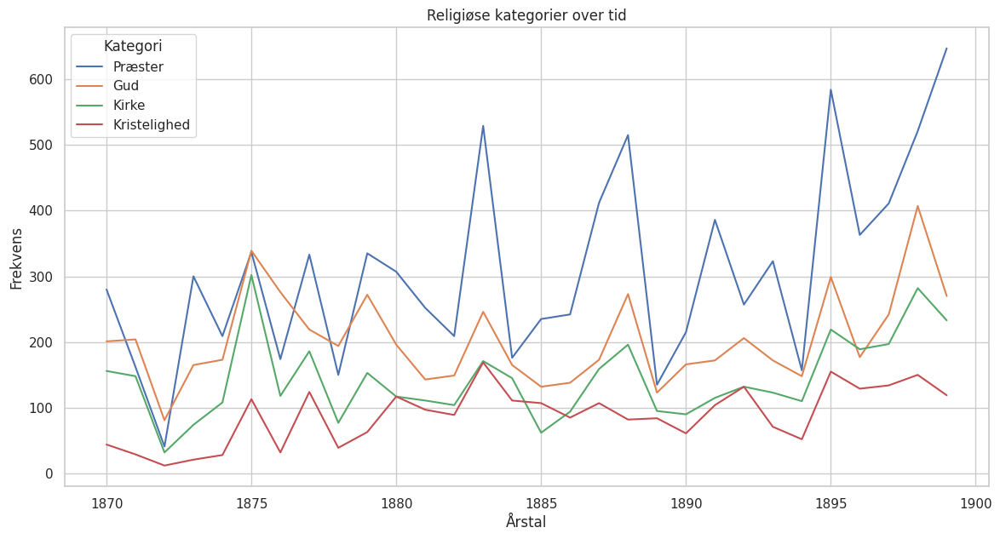

In [ ]:
df_grouped = df.groupby(['year', 'Category']).size().unstack(fill_value=0)

df_grouped['I alt'] = df_grouped.sum(axis=1)

df_grouped = df_grouped.reset_index()

df_grouped.columns.name = None

max_values = df_grouped.iloc[:, 1:-1].max()

sorted_categories = max_values.sort_values(ascending=False).index

plt.figure(figsize=(14, 7))

for category in sorted_categories:
    plt.plot(df_grouped['year'], df_grouped[category], label=f'{category}')

plt.title('Religiøse kategorier over tid')
plt.xlabel('Årstal')
plt.ylabel('Frekvens')

plt.legend(title='Kategori')
plt.grid(True)
plt.show()

In [ ]:
# Fem-års-intervaller

interval_df = df.copy()

bins = [1869, 1874, 1879, 1884, 1889, 1894, 1899]

intervals = ['1870-1874', '1875-1879', '1880-1884', '1885-1889', '1890-1894', '1895-1899']

interval_df['interval'] = pd.cut(interval_df['year'], bins, labels=intervals)

In [ ]:
interval_counts = interval_df.groupby('interval').size().reset_index(name='count')
print(interval_counts)

    interval  count
0  1870-1874   2468
1  1875-1879   3836
2  1880-1884   3603
3  1885-1889   3449
4  1890-1894   3192
5  1895-1899   5728


In [ ]:
total_count = interval_counts['count'].sum()

interval_counts['percentage'] = (interval_counts['count'] / total_count) * 100
print(interval_counts)

    interval  count  percentage
0  1870-1874   2468   11.079188
1  1875-1879   3836   17.220327
2  1880-1884   3603   16.174358
3  1885-1889   3449   15.483031
4  1890-1894   3192   14.329323
5  1895-1899   5728   25.713773


In [ ]:
interval_counts = interval_df.groupby(['interval', 'Category']).size().unstack(fill_value=0)

interval_counts = interval_counts.reset_index()

print(interval_counts)

Category   interval   Gud  Kirke  Kristelighed  Præster
0         1870-1874   824    518           134      992
1         1875-1879  1300    836           371     1329
2         1880-1884   899    648           583     1473
3         1885-1889   839    606           465     1539
4         1890-1894   864    570           420     1338
5         1895-1899  1395   1120           687     2526


In [ ]:
interval_counts.set_index('interval', inplace=True)

<Figure size 2000x1400 with 0 Axes>

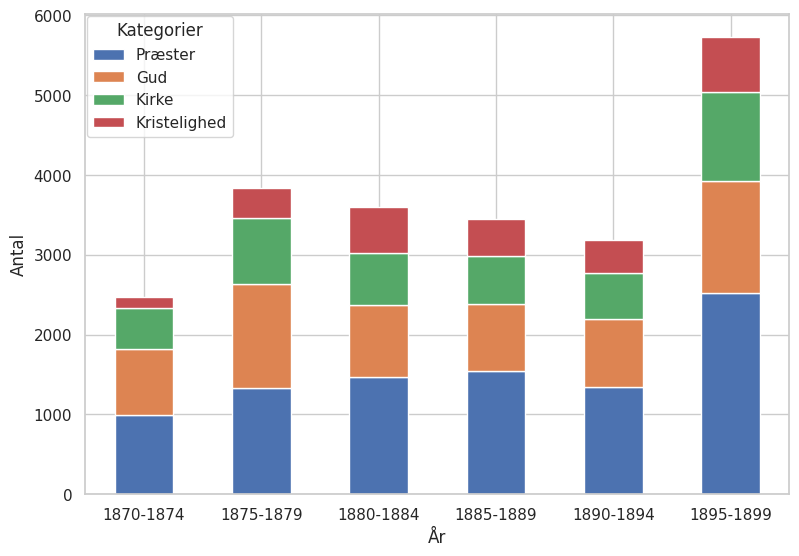

In [ ]:
desired_order = ['Præster', 'Gud', 'Kirke', 'Kristelighed']
interval_counts = interval_counts[desired_order]

plt.figure(figsize=(20, 14))
interval_counts.plot(kind='bar', stacked=True, width=0.5)
plt.xlabel('År')
plt.ylabel('Antal')
#plt.title('Religiøse kategorier fordelt på fem-års-intervaller')
plt.legend(title='Kategorier', loc='upper left', borderaxespad=0.1)
plt.xticks(rotation=0)
plt.subplots_adjust(left=0.1, right=1.2, top=1.2, bottom=0.2)
plt.show()

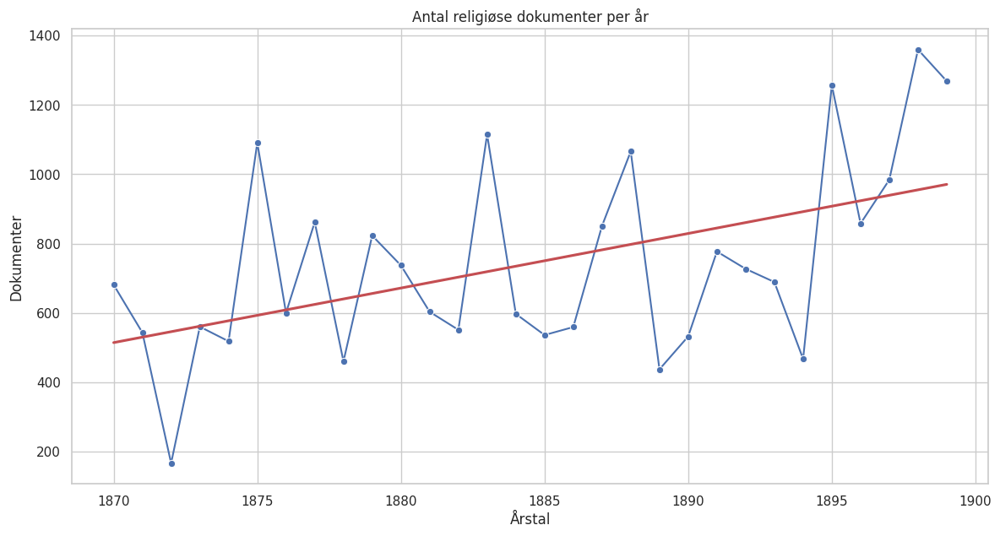

In [ ]:
# Distributionen af samtlige religiøse dokumenter i absolutte frekvenser

sns.set(style='whitegrid')

plt.figure(figsize=(14, 7))
sns.lineplot(data=df_grouped, x='year', y='I alt', marker='o', color='b')

sns.regplot(data=df_grouped, x='year', y='I alt', scatter=False, color='r', ci=None)

plt.xlabel('Årstal')
plt.ylabel('Dokumenter')
plt.title('Antal religiøse dokumenter per år')

plt.show()

Denne opadgående kurve tegner ikke et retmæssigt billede af distributionen af de religiøse dokumenter, eftersom romanproduktionen stiger markant i perioden. Her medregnes denne faktor, hvorefter vi ser et fald.

In [ ]:
novels_per_year = metadata_df.groupby('year')['filename'].nunique().reset_index(name='novels')
print(novels_per_year)

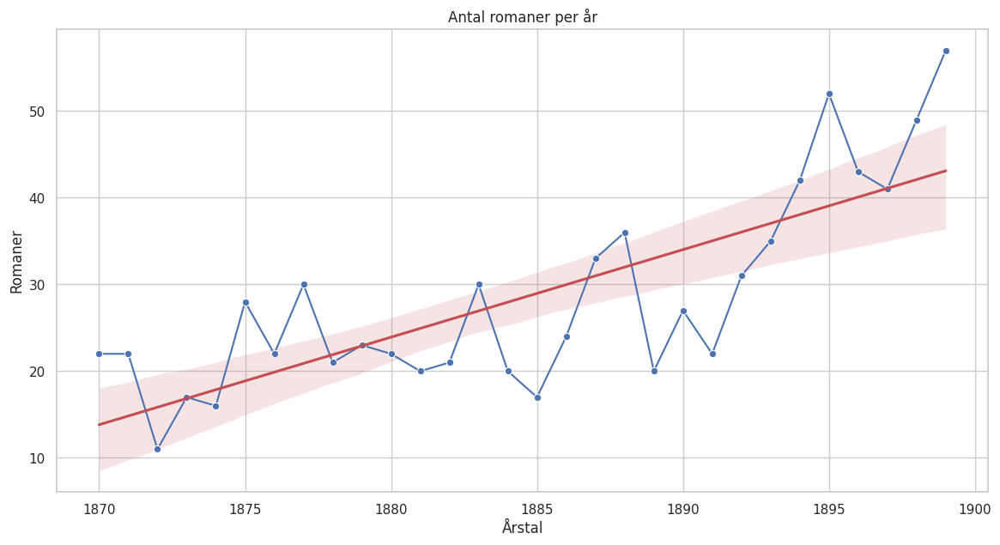

In [ ]:
sns.set(style='whitegrid')

plt.figure(figsize=(14, 7))
sns.lineplot(data=novels_per_year, x='year', y='novels', marker='o', color='b')

sns.regplot(data=novels_per_year, x='year', y='novels', scatter=False, color='r', ci=95)

plt.xlabel('Årstal')
plt.ylabel('Romaner')
plt.title('Antal romaner per år')

plt.show()

In [ ]:
# Dokumenterne skaleres til romanproduktionen
documents_and_novels_per_year = pd.merge(df_grouped, novels_per_year, on='year', how='left')
documents_and_novels_per_year['document_novel_ratio'] = documents_and_novels_per_year['I alt'] / documents_and_novels_per_year['novels']

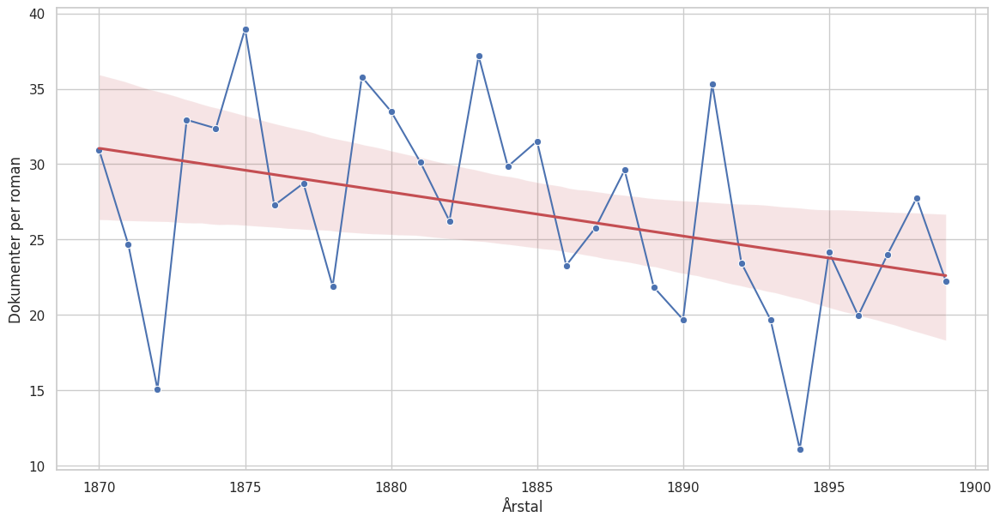

In [ ]:
plt.figure(figsize=(14, 7))
sns.lineplot(data=documents_and_novels_per_year, x='year', y='document_novel_ratio', marker='o', color='b')

sns.regplot(data=documents_and_novels_per_year, x='year', y='document_novel_ratio', scatter=False, color='r', ci=95)

plt.xlabel('Årstal')
plt.ylabel('Dokumenter per roman')

plt.show()

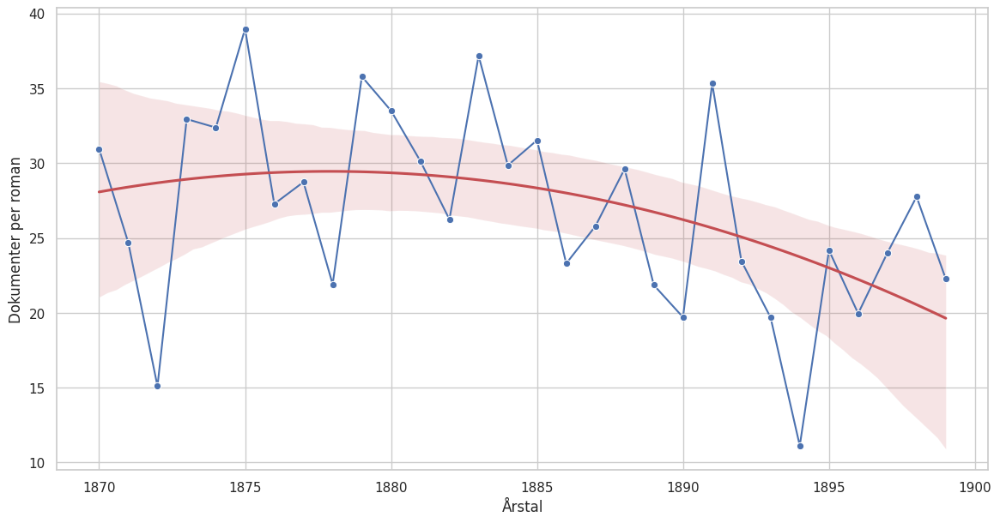

In [ ]:
plt.figure(figsize=(14, 7))
sns.lineplot(data=documents_and_novels_per_year, x='year', y='document_novel_ratio', marker='o', color='b')

sns.regplot(data=documents_and_novels_per_year, x='year', y='document_novel_ratio', order=2, scatter=False, color='r', ci=95)

plt.xlabel('Årstal')
plt.ylabel('Dokumenter per roman')
#plt.title('Dokumenter per roman per år')

plt.show()

## Kategorier

Her undersøges de romaner, hvor kategorien 'gud' er mest frekvent.

In [ ]:
god_df = df[df['Category'] == 'Gud']
god_df

,Unnamed: 0.1,Unnamed: 0,index corpora,Document,Topic,Name,Representation,Top_n_words,Probability,filename,...,gender,nationality,title,subtitle,year,pages,typeface,publisher,price,Category
3,3,3,318788,"— Ja , ved Gud , det skal han , svarede denne ...",778,778_bevares_herregud_gud_oh,"['bevares', 'herregud', 'gud', 'oh', 'ih', 'aa...",bevares - herregud - gud - oh - ih - aa - almæ...,0.000000,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Gud
4,4,4,318767,"— O Gud , hvad siger Du ?",31,31_gud_guds_herre_lovet,"['gud', 'guds', 'herre', 'lovet', 'tro', 'himl...",gud - guds - herre - lovet - tro - himlen - os...,0.933357,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Gud
5,5,5,318765,"— Dø , min Gud !",778,778_bevares_herregud_gud_oh,"['bevares', 'herregud', 'gud', 'oh', 'ih', 'aa...",bevares - herregud - gud - oh - ih - aa - almæ...,0.756685,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Gud
8,8,8,318319,"og brændende Vøn til Gud , om Styrke til at bæ...",31,105_præsten_kirken_kirke_pastor,"['præsten', 'kirken', 'kirke', 'pastor', 'præs...",præsten - kirken - kirke - pastor - præst - hu...,0.917342,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Gud
9,9,9,317386,"— Men , min Gud , hvem mener Du , fortæl mig d...",31,31_gud_guds_herre_lovet,"['gud', 'guds', 'herre', 'lovet', 'tro', 'himl...",gud - guds - herre - lovet - tro - himlen - os...,0.928492,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Gud
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22157,22157,22157,1094355,"» Jovel vil jeg det , lad mig bare faa Kæltrin...",31,31_gud_guds_herre_lovet,"['gud', 'guds', 'herre', 'lovet', 'tro', 'himl...",gud - guds - herre - lovet - tro - himlen - os...,0.871454,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,...,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Gud
22173,22173,22173,1095303,"Ja , Gud bevares , det var Bekker ganske enig ...",778,778_bevares_herregud_gud_oh,"['bevares', 'herregud', 'gud', 'oh', 'ih', 'aa...",bevares - herregud - gud - oh - ih - aa - almæ...,0.000000,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,...,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Gud
22218,22218,22218,1097569,"» Du har Ret , jeg maa gøre et Forsøg , enten ...",31,31_gud_guds_herre_lovet,"['gud', 'guds', 'herre', 'lovet', 'tro', 'himl...",gud - guds - herre - lovet - tro - himlen - os...,0.913174,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,...,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Gud
22225,22225,22225,1097414,"At man vilde gøre hendes Mand ondt , det følte...",31,31_gud_guds_herre_lovet,"['gud', 'guds', 'herre', 'lovet', 'tro', 'himl...",gud - guds - herre - lovet - tro - himlen - os...,0.000000,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,...,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Gud


In [ ]:
value_counts = god_df['filename'].value_counts().reset_index()
value_counts.columns = ['filename', 'Count']
value_counts

,filename,Count
0,1898_RygaardHo_Kongesvaerdet.paragraphed.txt_o...,100
1,1876_Karstens_FrederikFolkekjaer.paragraphed.t...,88
2,1875_Lassen_KongGormsSoennerEllerKorsOgSvaerd....,68
3,1888_Ridderhjelm_FrelstEllerFiskerensDatter.pa...,62
4,1875_Karstens_GrevindeDanner_2.paragraphed.txt...,59
...,...,...
760,1895_Tuxen_EvaRoss.paragraphed.txt_ocrfixed.pa...,1
761,1885_Pontoppidan_UngElskov.paragraphed.txt_ocr...,1
762,1895_Roth_PaaOpmaaling.paragraphed.txt_ocrfixe...,1
763,1895_Nording_GamleJomfruer.paragraphed.txt_ocr...,1


In [ ]:
documents_per_category_per_novel = god_df.groupby(['filename','Category', 'year', 'pages']).agg(
    dokumenter=('Document', 'count')
).reset_index()

documents_per_category_per_novel['dokumenter/sidetal'] = documents_per_category_per_novel['dokumenter'] / documents_per_category_per_novel['pages']
documents_per_category_per_novel

,filename,Category,year,pages,dokumenter,dokumenter/sidetal
0,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,Gud,1870,362.0,7,0.019337
1,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,Gud,1870,183.0,2,0.010929
2,1870_Anonym_KraemmersvendeOgSyjomfruerEllerPri...,Gud,1870,355.0,14,0.039437
3,1870_Anonym_StokhusslavenSoerenVintyvEllerForb...,Gud,1870,476.0,20,0.042017
4,1870_Anonym_TestamentforfalskningenEllerBetler...,Gud,1870,458.0,13,0.028384
...,...,...,...,...,...,...
759,1899_Wende_KjaerlighedensKamp_1.paragraphed.tx...,Gud,1899,652.0,19,0.029141
760,1899_Wende_KjaerlighedensKamp_2.paragraphed.tx...,Gud,1899,590.0,12,0.020339
761,1899_Wied_LivsensOndskab.paragraphed.txt_ocrfi...,Gud,1899,390.0,12,0.030769
762,1899_WintherH_PaaFremmedGrund.paragraphed.txt_...,Gud,1899,180.0,2,0.011111


## Forfatterskaber og romaner

Her undersøges distributionen af de religiøse dokumenter i romanerne og forfatterskaberne. Koden fremhæver de romaner mest religiøse dokumenter og dem uden religiøse dokumenterne, hvorefter et datasæt etableres til nærmere inspektion.

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/df_med_kategorier_ny.csv')

In [ ]:
# Ny kolonne til forfatternavn
df['author_name'] = (df['firstname'].str.strip() + ' ' + df['surname'].str.strip()).str.replace(r'\s+', ' ', regex=True)
# Hvis et forfatternavn ikke er identificeret bruges et evt. pseudonym
df['author_name'].fillna(df['pseudonym'], inplace=True)

In [ ]:
unique_filenames_df = df['filename'].value_counts().reset_index()
unique_filenames_df.columns = ['filnavn', 'antal dokumenter']
unique_filenames_df

In [ ]:
unique_filenames_count = df['filename'].nunique()

print(f'The number of unique filenames is: {unique_filenames_count}')

In [ ]:
unique_filenames_count = metadata_df['filename'].nunique()

print(f'The number of unique filenames is: {unique_filenames_count}')

In [ ]:
unique_filenames_filtered = metadata_df['filename'].unique()
filenames_not_in_df = set(unique_filenames_filtered) - set(df['filename'].unique())
filenames_not_in_df_list = list(filenames_not_in_df)

filenames_not_in_df_list

In [ ]:
documents_per_author = df.groupby('author_name')['Document'].count().reset_index(name='document_count')

documents_per_author.columns = ['Forfatter', 'Antal dokumenter']
documents_per_author

In [ ]:
author_statistics = df.groupby('author_name').agg(
    dokumenter=('Document', 'count'),
    romaner=('title', 'nunique')
).reset_index()

author_statistics['gennemsnit_per_roman'] = author_statistics['dokumenter'] / author_statistics['romaner']
author_statistics

In [ ]:
# author_statistics.to_excel('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/religion_forfatterskab.xlsx')

## Forlag

Her undersøges distributionen af de religiøse dokumenter med afsæt i periodens forlag, som er inddelt i fire grupper efter størrelse: Gyldendal, store forlag, mellemstore forlag og små forlag.

In [ ]:
#indlæs data

metadata_df = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/metadata_renset_og_tilpasset_korpus.csv')
df = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/df_med_kategorier_ny.csv')

In [ ]:
# Fem-års-intervaller metadata

bins = [1869, 1874, 1879, 1884, 1889, 1894, 1899]

intervals = ['1870-1874', '1875-1879', '1880-1884', '1885-1889', '1890-1894', '1895-1899']

metadata_df['interval'] = pd.cut(metadata_df['year'], bins, labels=intervals)

In [ ]:
def map_publisher_size(count):
    if count > 100:
        return 'Gyldendal'
    elif count > 30:
        return 'Store forlag'
    elif count > 5:
        return 'Mellemstore forlag'
    else:
        return 'Små forlag'

In [ ]:
metadata_df['publisher size'] = metadata_df['novels by publisher'].apply(map_publisher_size)
metadata_df

,Unnamed: 0.1,Unnamed: 0,filename,firstname,surname,pseudonym,gender,nationality,title,subtitle,year,pages,typeface,publisher,price,author_name,novels by publisher,publisher size,interval
0,0,0,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,H.C.,Andersen,NaN,m,dk,Lykke-Peer,NaN,1870,183.0,gothic,Reitzel,2.25,H.C. Andersen,63.0,Store forlag,1870-1874
1,1,1,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,Carl,Brosbøll,Carit Etlar,m,dk,Tranens Varsel,En Roman,1870,528.0,gothic,Chr. Steen & Søn,5.5,Carl Brosbøll,10.0,Mellemstore forlag,1870-1874
2,2,2,1870_Dodt_AegteOgUaegte.paragraphed.txt_ocrfix...,Beatus,Dodt,NaN,m,dk,Ægte og Uægte,Livsbillede,1870,517.0,gothic,Chr. Steen & Søn,5.35,Beatus Dodt,10.0,Mellemstore forlag,1870-1874
3,3,3,1870_Friis_MoedetPaaLaesoe.paragraphed.txt_ocr...,J.J.F.,Friis,NaN,m,dk,Mødet paa Læsø,En Fortælling,1870,164.0,gothic,Chr. Steen & Søn,1.85,J.J.F. Friis,10.0,Mellemstore forlag,1870-1874
4,4,4,1870_Friis_MagnusHeinesen.paragraphed.txt_ocrf...,J.J.F.,Friis,NaN,m,dk,Magnus Heinesen,En historisk Roman,1870,209.0,gothic,Chr. Steen & Søn,2.35,J.J.F. Friis,10.0,Mellemstore forlag,1870-1874
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
849,849,849,1879_Anselmo_AmelieEllerLivIDoeden.paragraphed...,NaN,NaN,Viktor de Anselmo,ukendt,ukendt,Amelie eller Liv i Døden,Efter en afdød Jordemoders Meddelelser. Roman,1879,480.0,gothic,Lohmannske Forlagsforretning,3,Viktor de Anselmo,1.0,Små forlag,1875-1879
850,850,850,1899_Wied_LivsensOndskab.paragraphed.txt_ocrfi...,Gustav,Wied,NaN,m,dk,Livsens Ondskab,Billeder fra Gammelkøbing,1899,390.0,roman,Gyldendal,5.5,Gustav Wied,221.0,Gyldendal,1895-1899
851,851,851,1899_WintherH_PaaFremmedGrund.paragraphed.txt_...,Hedevig,Winther,NaN,f,dk,Paa fremmed Grund,Fortælling,1899,180.0,roman,Jens Møller,2.25,Hedevig Winther,8.0,Mellemstore forlag,1895-1899
852,852,852,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,Peter Anton,Worm,anonym,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Peter Anton Worm,1.0,Små forlag,1895-1899


In [ ]:
docs_df = df.copy()

columns_to_drop = ['Top_n_words', 'Probability', 'Document', 'Topic', 'Name', 'Representation', 'firstname', 'surname', 'pseudonym', 'gender', 'nationality', 'title', 'subtitle', 'typeface', 'price', 'year', 'publisher']
docs_df = docs_df.drop(columns=columns_to_drop)

In [ ]:
filename_counts = docs_df['filename'].value_counts()

docs_df['dokumenter'] = docs_df['filename'].map(filename_counts)

docs_df = docs_df.drop_duplicates(subset='filename')

new_column_order = ['filename', 'dokumenter']
docs_df = docs_df[new_column_order]

In [ ]:
merged_df = pd.merge(metadata_df, docs_df, on='filename', how='left')
merged_df

,Unnamed: 0.1,Unnamed: 0,filename,firstname,surname,pseudonym,gender,nationality,title,subtitle,year,pages,typeface,publisher,price,author_name,novels by publisher,publisher size,interval,dokumenter
0,0,0,1870_AndersenHC_LykkePeer.paragraphed.txt_ocrf...,H.C.,Andersen,NaN,m,dk,Lykke-Peer,NaN,1870,183.0,gothic,Reitzel,2.25,H.C. Andersen,63.0,Store forlag,1870-1874,12.0
1,1,1,1870_Brosboell_TranensVarsel.paragraphed.txt_o...,Carl,Brosbøll,Carit Etlar,m,dk,Tranens Varsel,En Roman,1870,528.0,gothic,Chr. Steen & Søn,5.5,Carl Brosbøll,10.0,Mellemstore forlag,1870-1874,40.0
2,2,2,1870_Dodt_AegteOgUaegte.paragraphed.txt_ocrfix...,Beatus,Dodt,NaN,m,dk,Ægte og Uægte,Livsbillede,1870,517.0,gothic,Chr. Steen & Søn,5.35,Beatus Dodt,10.0,Mellemstore forlag,1870-1874,31.0
3,3,3,1870_Friis_MoedetPaaLaesoe.paragraphed.txt_ocr...,J.J.F.,Friis,NaN,m,dk,Mødet paa Læsø,En Fortælling,1870,164.0,gothic,Chr. Steen & Søn,1.85,J.J.F. Friis,10.0,Mellemstore forlag,1870-1874,57.0
4,4,4,1870_Friis_MagnusHeinesen.paragraphed.txt_ocrf...,J.J.F.,Friis,NaN,m,dk,Magnus Heinesen,En historisk Roman,1870,209.0,gothic,Chr. Steen & Søn,2.35,J.J.F. Friis,10.0,Mellemstore forlag,1870-1874,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
849,849,849,1879_Anselmo_AmelieEllerLivIDoeden.paragraphed...,NaN,NaN,Viktor de Anselmo,ukendt,ukendt,Amelie eller Liv i Døden,Efter en afdød Jordemoders Meddelelser. Roman,1879,480.0,gothic,Lohmannske Forlagsforretning,3,Viktor de Anselmo,1.0,Små forlag,1875-1879,33.0
850,850,850,1899_Wied_LivsensOndskab.paragraphed.txt_ocrfi...,Gustav,Wied,NaN,m,dk,Livsens Ondskab,Billeder fra Gammelkøbing,1899,390.0,roman,Gyldendal,5.5,Gustav Wied,221.0,Gyldendal,1895-1899,35.0
851,851,851,1899_WintherH_PaaFremmedGrund.paragraphed.txt_...,Hedevig,Winther,NaN,f,dk,Paa fremmed Grund,Fortælling,1899,180.0,roman,Jens Møller,2.25,Hedevig Winther,8.0,Mellemstore forlag,1895-1899,19.0
852,852,852,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,Peter Anton,Worm,anonym,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Peter Anton Worm,1.0,Små forlag,1895-1899,339.0


In [ ]:
novel_per_publisher_group = merged_df.groupby(['publisher size']).size().reset_index(name='novels')
novel_per_publisher_group

,publisher size,novels
0,Gyldendal,221
1,Mellemstore forlag,219
2,Små forlag,177
3,Store forlag,237


In [ ]:
novel_count = merged_df.groupby(['publisher size', 'interval']).size().reset_index(name='novels')
doc_count = merged_df.groupby(['interval', 'publisher size']).agg({'dokumenter': 'sum'}).reset_index()

In [ ]:
merged_counts = pd.merge(doc_count, novel_count, on=['interval', 'publisher size'])
merged_counts['novel_ratio'] = merged_counts['dokumenter'] / merged_counts['novels']

order = ['Gyldendal', 'Store forlag', 'Mellemstore forlag', 'Små forlag']

merged_counts['publisher size'] = pd.Categorical(merged_counts['publisher size'], categories=order, ordered=True)
merged_counts = merged_counts.sort_values(by=['publisher size', 'interval'])

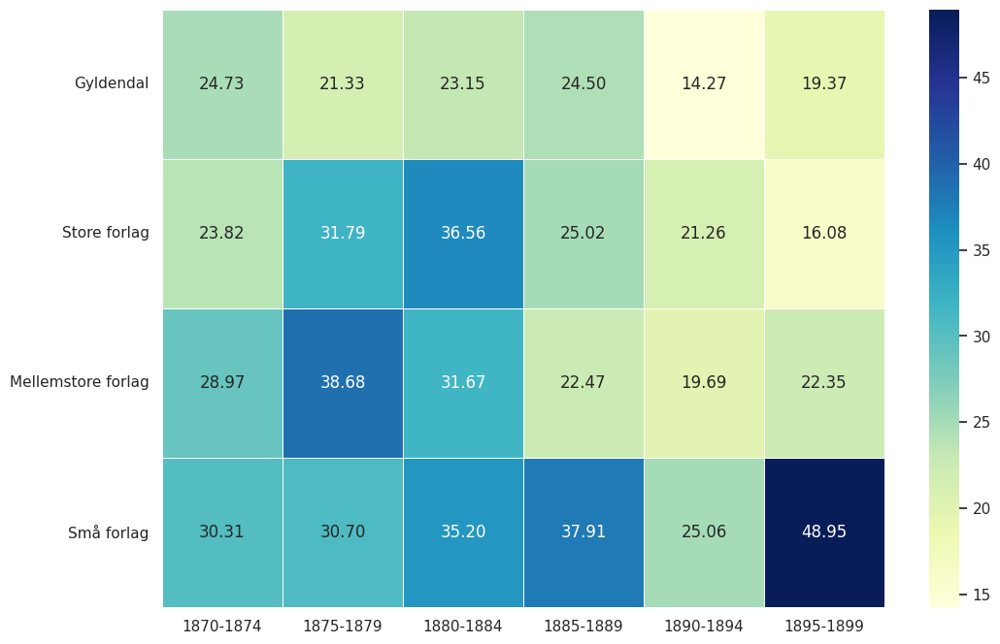

In [ ]:
heatmap_data = merged_counts.pivot_table(index='publisher size', columns='interval', values='novel_ratio')

plt.figure(figsize=(12, 8))
sns.set(font_scale=1)

ax = sns.heatmap(heatmap_data, cmap='YlGnBu', annot=True, fmt='.2f', linewidths=.5)

ax.set_xlabel('')
ax.set_ylabel('')

ax.set_xticklabels(ax.get_xticklabels(), rotation=0)
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)

#plt.title('Dokumenter per roman for forlagene')
plt.show()

In [ ]:
mean_pages_per_publisher = merged_df.groupby('publisher size')['pages'].mean().reset_index()

mean_pages_per_publisher.columns = ['publisher_size', 'mean_pages']
mean_pages_per_publisher

,publisher_size,mean_pages
0,Gyldendal,280.199095
1,Mellemstore forlag,353.990868
2,Små forlag,357.250000
3,Store forlag,263.054852


In [ ]:
doc_count = merged_df.groupby(['interval', 'publisher size']).agg({'dokumenter': 'sum'}).reset_index()
page_count = merged_df.groupby(['interval', 'publisher size']).agg({'pages': 'sum'}).reset_index()

In [ ]:
merged_counts = pd.merge(doc_count, page_count, on=['interval', 'publisher size'])
merged_counts['page_ratio'] = merged_counts['dokumenter'] / merged_counts['pages']

order = ['Gyldendal', 'Store forlag', 'Mellemstore forlag', 'Små forlag']

merged_counts['publisher size'] = pd.Categorical(merged_counts['publisher size'], categories=order, ordered=True)
merged_counts = merged_counts.sort_values(by=['publisher size', 'interval'])

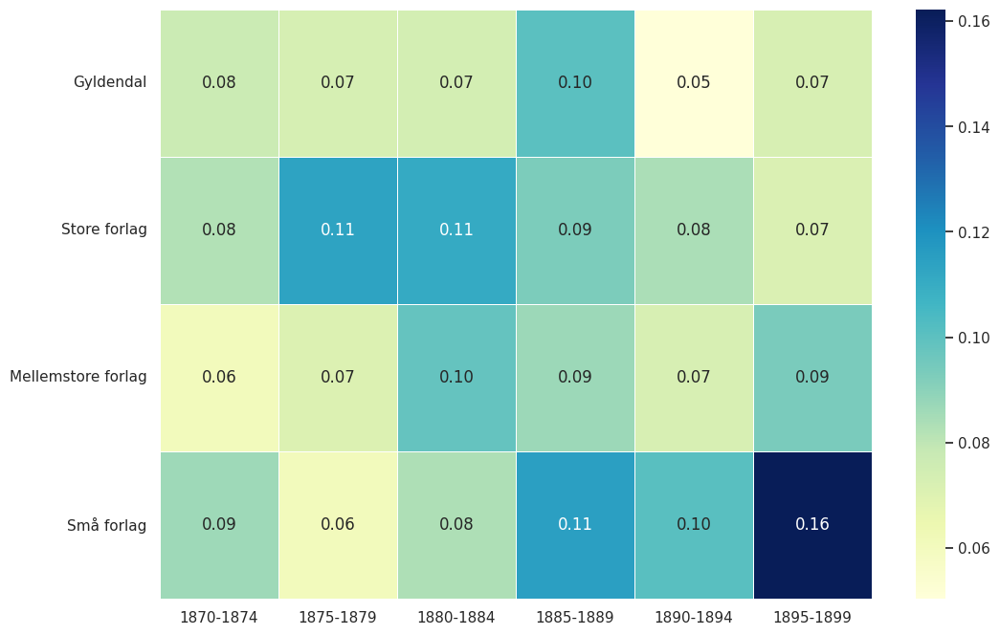

In [ ]:
heatmap_data = merged_counts.pivot_table(index='publisher size', columns='interval', values='page_ratio')

plt.figure(figsize=(12, 8))
sns.set(font_scale=1)

ax = sns.heatmap(heatmap_data, cmap='YlGnBu', annot=True, fmt='.2f', linewidths=.5)

ax.set_xlabel('')
ax.set_ylabel('')

ax.set_xticklabels(ax.get_xticklabels(), rotation=0)
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)

#plt.title('Dokumenter per roman for forlagene')
plt.show()

In [ ]:
# Liste over mellemstore forlag

publishers_medium = metadata_df[metadata_df['publisher size'] == 'Mellemstore forlag']
publisher_book_counts = publishers_medium.groupby('publisher').size().reset_index(name='novel_count')
publisher_book_counts


,publisher,novel_count
0,A. Behrend,26
1,Cammermeyer,6
2,Carl Lund,9
3,Chr. Steen & Søn,10
4,Erslev,7
5,Gad,9
6,Gjellerup,6
7,Hagerup,17
8,Høst,11
9,J. L. Wulff,10


In [ ]:
# Liste over små forlag

publishers_small = metadata_df[metadata_df['publisher size'] == 'Små forlag']
publisher_book_counts = publishers_small.groupby('publisher').size().reset_index(name='novel_count')
publisher_book_counts

,publisher,novel_count
0,A. Andersen,5
1,A. C. Riemenschneiders Forlag,1
2,A. Christensen,3
3,A. Christiansen,3
4,A. Jacobsen,1
...,...,...
94,V. Pontoppidan,1
95,W. Janssen,3
96,Wroblewsky,3
97,Z. Richter,1


## Sentiment

Her klassificeres de religiøse dokumenter med en sentimentmodel, hvorefter distributionen af positive, negative og neutrale visualiseres procentvis for de enkelte år. Først gælder det alle dokumenterne og dernæst specifikt dokumenterne i kategorien 'gud'.

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/df_med_kategorier_ny.csv')

In [ ]:
model_name = "MiMe-MeMo/MeMo-BERT-SA"
model = AutoModelForSequenceClassification.from_pretrained(model_name)
tokenizer = AutoTokenizer.from_pretrained(model_name)

In [ ]:
input_texts = df['Document'].tolist()
labels = None
input_texts

In [ ]:
model.to('cuda')

batch_size = 256

predicted_labels_text_all = []
predicted_scores_all = []

for i in range(0, len(input_texts), batch_size):
    batch_input_texts = input_texts[i:i+batch_size]

    inputs = tokenizer(batch_input_texts, padding='max_length', max_length=512, truncation=True, return_tensors="pt").to('cuda')

    with torch.no_grad():
        outputs = model(**inputs)

    logits = outputs.logits
    predicted_labels = torch.argmax(logits, dim=1)

    predicted_labels_text = [model.config.id2label[label_id.item()] for label_id in predicted_labels]

    softmax_scores = torch.softmax(logits, dim=1)
    predicted_scores = softmax_scores.max(dim=1).values.tolist()

    predicted_labels_text_all.extend(predicted_labels_text)
    predicted_scores_all.extend(predicted_scores)

for label, score in zip(predicted_labels_text_all[:10], predicted_scores_all[:10]):
    print("Label:", label)
    print("Score:", score)

In [ ]:
df['Sentiment']= predicted_labels_text_all
df['Score'] = predicted_scores_all
df

In [ ]:
#df.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/df_med_sentiment.csv')

In [ ]:
#df.to_excel('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/df_med_sentiment.xlsx')

In [ ]:
df['Sentiment'] = df['Sentiment'].replace({'Negative': 'Negativ', 'Positive': 'Positiv'})

In [ ]:
value_counts = df['Sentiment'].value_counts()
value_counts

Sentiment
Negativ    11005
Positiv     6409
Neutral     4862
Name: count, dtype: int64

In [ ]:
colors = {
    'Positiv': '#008000',  # Rød
    'Negativ': '#B22222',  # Grøn
    'Neutral': '#00008B'    # Blå
}

Her ses den procentvise sentimentfordeling over tid for samtlige religiøse dokumenter.

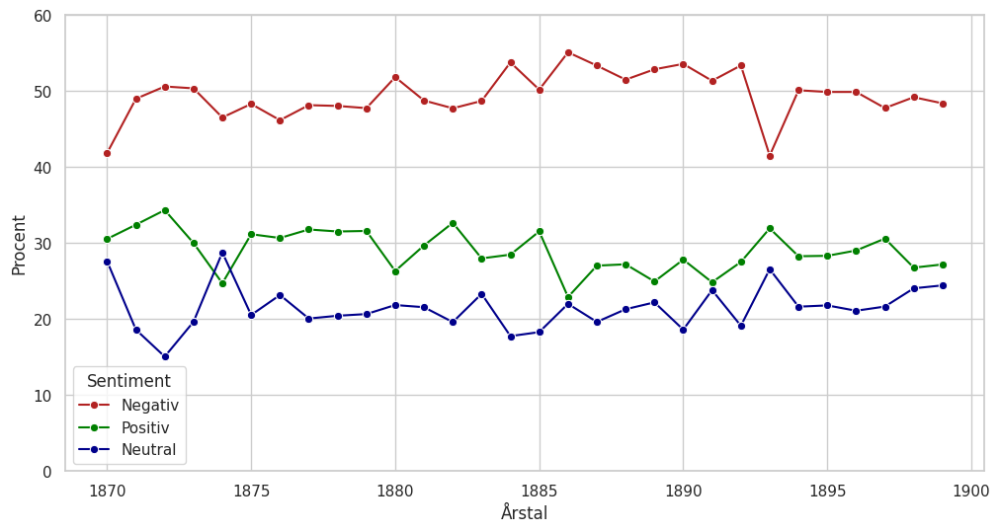

In [ ]:
df_grouped = df.groupby(['year', 'Sentiment']).size().reset_index(name='Count')

yearly_totals = df_grouped.groupby('year')['Count'].sum().reset_index(name='Total')

df_grouped = df_grouped.merge(yearly_totals, on='year')

df_grouped['Percentage'] = (df_grouped['Count'] / df_grouped['Total']) * 100

plt.figure(figsize=(12, 6))
plt.ylim(0, 60)
sns.lineplot(x='year', y='Percentage', hue='Sentiment', marker='o', data=df_grouped, palette=colors, hue_order=['Negativ', 'Positiv', 'Neutral'])

#plt.title('Sentimentfordeling skaleret procentvist per år')
plt.xlabel('Årstal')
plt.ylabel('Procent')

plt.legend(title='Sentiment')
plt.grid(True)
plt.show()

Her ses den procentvise sentimentfordeling over tid for segmenterne i kategorien 'gud'.

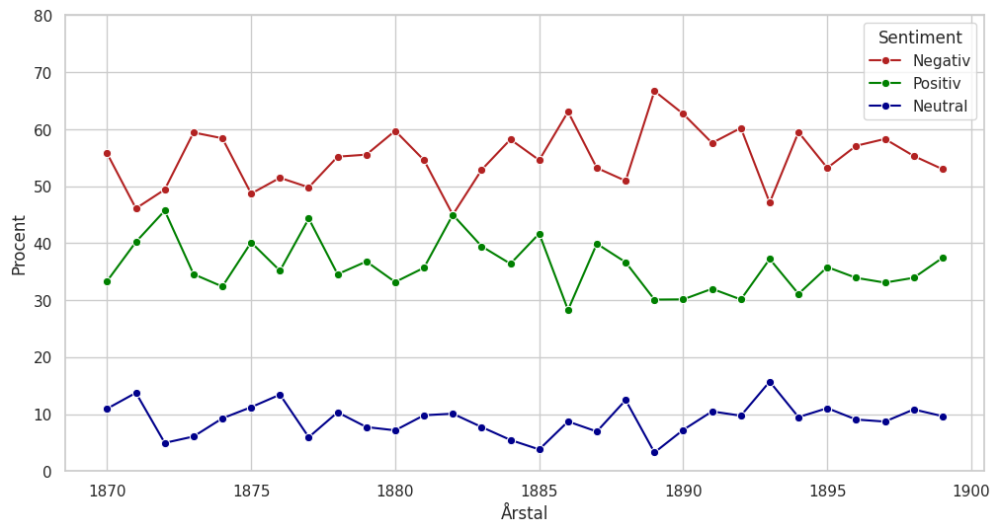

In [ ]:
god_df = df[df['Category'] == 'Gud']

df_grouped = god_df.groupby(['year', 'Sentiment']).size().reset_index(name='Count')

yearly_totals = df_grouped.groupby('year')['Count'].sum().reset_index(name='Total')

df_grouped = df_grouped.merge(yearly_totals, on='year')

df_grouped['Percentage'] = (df_grouped['Count'] / df_grouped['Total']) * 100

sns.set_style("whitegrid")

plt.figure(figsize=(12, 6))
plt.ylim(0, 80)
sns.lineplot(x='year', y='Percentage', hue='Sentiment', marker='o', data=df_grouped, palette=colors, hue_order=['Negativ', 'Positiv', 'Neutral'])

#plt.title('Sentiment over tid for Gud (procentvis)')
plt.xlabel('Årstal')
plt.ylabel('Procent')

plt.legend(title='Sentiment')
plt.grid(True)
plt.show()

## Præster vs. læger

Her sammenlignes distributionen af præste-topics og læge-topics over tid.

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/df_med_kategorier_ny.csv')

In [ ]:
priest_df = df[df['Category'] == 'Præster']
priest_df

,Unnamed: 0.1,Unnamed: 0,index corpora,Document,Topic,Name,Representation,Top_n_words,Probability,filename,...,gender,nationality,title,subtitle,year,pages,typeface,publisher,price,Category
1,1,1,318920,"— Amen ! hviskede en ung Kvinde , der ubemærke...",60,105_præsten_kirken_kirke_pastor,"['præsten', 'kirken', 'kirke', 'pastor', 'præs...",præsten - kirken - kirke - pastor - præst - hu...,0.544451,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Præster
6,6,6,318349,"— Ja , men det er snart fortalt . Jeg har her ...",60,60_præst_præsten_pastor_pastoren,"['præst', 'præsten', 'pastor', 'pastoren', 'bi...",præst - præsten - pastor - pastoren - bispen -...,0.517200,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Præster
12,12,12,316319,"— Nei , holdt , afbrød Knækbcin hende . Den Le...",60,105_præsten_kirken_kirke_pastor,"['præsten', 'kirken', 'kirke', 'pastor', 'præs...",præsten - kirken - kirke - pastor - præst - hu...,0.730484,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Præster
13,13,13,316317,"— Godt , saa befaler jeg Dig øieblikkelig at f...",60,60_præst_præsten_pastor_pastoren,"['præst', 'præsten', 'pastor', 'pastoren', 'bi...",præst - præsten - pastor - pastoren - bispen -...,0.000000,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Præster
14,14,14,316289,"der ligger i Kisten derhenne , thi nu henter j...",60,60_præst_præsten_pastor_pastoren,"['præst', 'præsten', 'pastor', 'pastoren', 'bi...",præst - præsten - pastor - pastoren - bispen -...,0.000000,1870_AT_DenVanvittigesBoernEllerSkurkenPaaNoer...,...,ukendt,dk,Den Vanvittiges Børn eller Skurken paa Nørrebro,Original romantisk Fortælling,1870,362.0,gothic,Behrends Enke,1.08,Præster
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22271,22271,22271,1096477,Præsten holdt sit Aandedræt tilbage og lagde Ø...,60,553_kirken_kirkedøren_præsten_døren,"['kirken', 'kirkedøren', 'præsten', 'døren', '...",kirken - kirkedøren - præsten - døren - indgan...,0.858869,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,...,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Præster
22272,22272,22272,1096466,"Præsten gik ogsaa ind i sine Værelser , men — ...",130,130_præsten_kardinalen_præst_præstens,"['præsten', 'kardinalen', 'præst', 'præstens',...",præsten - kardinalen - præst - præstens - past...,0.000000,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,...,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Præster
22273,22273,22273,1096430,Greven var naturligvis meget fornøjet med Præs...,130,130_præsten_kardinalen_præst_præstens,"['præsten', 'kardinalen', 'præst', 'præstens',...",præsten - kardinalen - præst - præstens - past...,0.809612,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,...,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Præster
22274,22274,22274,1096710,» Hvad hedder den Præst ? «,60,60_præst_præsten_pastor_pastoren,"['præst', 'præsten', 'pastor', 'pastoren', 'bi...",præst - præsten - pastor - pastoren - bispen -...,0.730208,1899_Worm_ForbrydelsernesKongeEllerDenSkalpere...,...,m,dk,Forbrydelsernes Konge eller Den skalperede Præst,NaN,1899,888.0,roman,Emil F. Petersen,3.3,Præster


In [ ]:
df_grouped_priests = priest_df.groupby(['year', 'Category']).size().unstack(fill_value=0)

df_grouped_priests = df_grouped_priests.reset_index()

df_grouped_priests.columns.name = None

In [ ]:
big_publishers = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SF_documentinfo_OG_FILNAVN_med_outlierreduction.csv')

selected_topic = [0]
df_big_publishers = big_publishers[big_publishers['Topic'].isin(selected_topic)]

df_big_publishers.rename(columns={'filename_1': 'filename'}, inplace=True)
df_big_publishers.drop(columns={'year_1'}, inplace=True)
df_big_publishers.drop(columns=['Representative_Docs'], inplace=True)
df_big_publishers.drop(columns=['Representative_document'], inplace=True)

df_big_publishers

In [ ]:
small_publishers = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/SmF_documentinfo_OG_FILNAVN_med_outlierreduction.csv')

selected_topic = [4]
df_small_publishers = small_publishers[small_publishers['Topic'].isin(selected_topic)]

df_small_publishers.rename(columns={'filename_2': 'filename'}, inplace=True)
df_small_publishers.drop(columns={'year_2'}, inplace=True)
df_small_publishers.drop(columns=['Representative_Docs'], inplace=True)
df_small_publishers.drop(columns=['Representative_document'], inplace=True)
df_small_publishers

In [ ]:
df = pd.concat([df_big_publishers, df_small_publishers])
df.sort_values(by='filename', inplace=True)

In [ ]:
df['Category'] = 'Læger'

In [ ]:
# df.to_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/doktor_df.csv')

In [ ]:
df_grouped_doctors = df.groupby(['year', 'Category']).size().unstack(fill_value=0)

df_grouped_doctors = df_grouped_doctors.reset_index()

df_grouped_doctors.columns.name = None

In [ ]:
df = df_grouped_priests.merge(df_grouped_doctors, how="left", on="year")

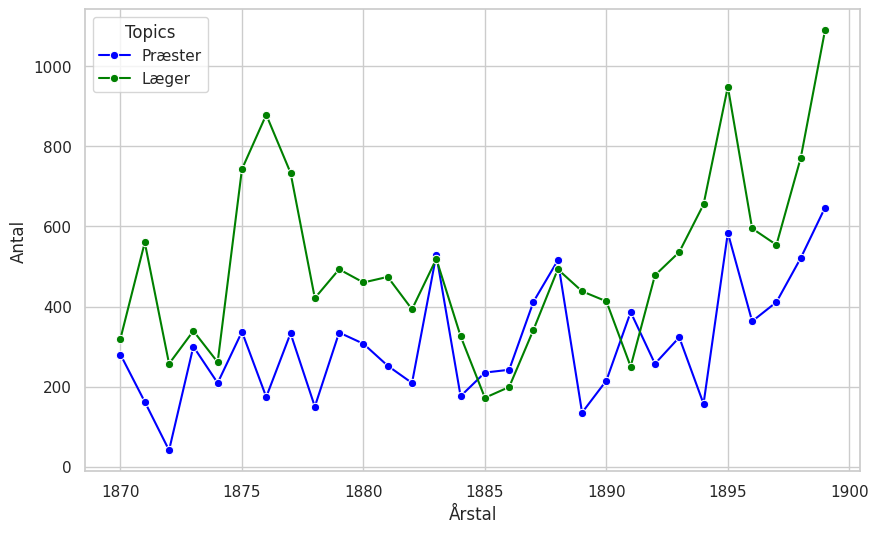

In [ ]:
plt.figure(figsize=(10, 6))

sns.lineplot(data=df, x='year', y='Præster', marker='o', label='Præster', color='blue')

sns.lineplot(data=df, x='year', y='Læger', marker='o', label='Læger', color='green')

plt.xlabel('Årstal')
plt.ylabel('Antal')
#plt.title('Counts of Præster and Læger per Year')
plt.legend(title='Topics')
plt.show()

## Fritænkere

Her gennemsøges korpusset for fritænkning med afsæt i en ordliste og et regulært udtryk, der fanger variationer af ordene. Efterfølgende tælles ordene i datasættet, således at i de tilfælde, hvor et segment indeholder mere end ét af ordene, indgår de øvrige forekomster i optællingen. Herefter undersøges distributionen på forfatterskabsniveau.

In [ ]:
dir_path = "/content/drive/MyDrive/Notebooks_and_data/romankorpus.v1.1_w_OCR_error_corrections_paragraphed"
filenames = sorted(os.listdir(dir_path))

In [ ]:
keywords = ["Ateisme", "Atheisme", "Ateist", "Atheist", "Fritænker", "Fritænkeri", "Darwin", "Brandes", "Spencer", "Taine"]

pattern = r'\b(?:' + '|'.join(keywords) + r')\w*\b'

df_list = []

for filename in filenames:
    if filename.endswith(".txt"):
        with open(os.path.join(dir_path, filename), "r", encoding="utf-8") as file:
            content = file.read()

            sentence_pattern = r'([^.!?]+[.!?])'
            sentences = re.findall(sentence_pattern, content)

            for i, sentence in enumerate(sentences):
                match = re.search(pattern, sentence, re.IGNORECASE)
                if match:
                    start_idx = max(0, i - 1)
                    end_idx = min(len(sentences), i + 2)
                    keyword_sentence = sentences[i]
                    sentences_list = sentences[start_idx:end_idx]

                    segments = ' '.join(sentences_list)

                    df = pd.DataFrame({'index': [i], 'filename': [filename], 'segment': [segments]})

                    df_list.append(df)

df = pd.concat(df_list, ignore_index=True)

In [ ]:
# df.to_excel('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/fritænkere.xlsx')

In [ ]:
metadata_df = pd.read_csv('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/metadata_renset_og_tilpasset_korpus.csv')

In [ ]:
fritænker_df = pd.read_excel('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/fritænkere.xlsx')

In [ ]:
df = fritænker_df.merge(metadata_df, how="left", on="filename")

In [ ]:
# df.to_excel('/content/drive/MyDrive/Notebooks_and_data/religion_og_sekularisering/fritænker_df.xlsx')

In [ ]:
keywords = ["Ateisme", "Atheisme", "Ateist", "Atheist", "Fritænker", "Fritænkeri", "Darwin", "Brandes", "Spencer", "Taine"]

pattern = r'\b(?:' + '|'.join(keywords) + r')\w*\b'

df['matches'] = df['segment'].str.findall(pattern)

df_exploded = df.explode('matches')

keyword_counts = df_exploded['matches'].value_counts().reset_index()
keyword_counts.columns = ['keyword', 'count']

keyword_counts

,keyword,count
0,Fritænker,244
1,Darwin,94
2,Brandes,76
3,Fritænkere,76
4,Atheist,48
5,Fritænkerne,46
6,Fritænkeri,32
7,Spencer,28
8,Fritænkeren,23
9,Fritænkeriet,22


In [ ]:
total_count = keyword_counts['count'].sum()

total_count

886

In [ ]:
author_keyword_counts = df_exploded.groupby('author_name')['matches'].size().reset_index()
author_keyword_counts.columns = ['author', 'keyword_count']

top_10_authors = author_keyword_counts.sort_values(by='keyword_count', ascending=False).head(10)

top_10_authors

,author,keyword_count
112,Sophus Schandorph,82
72,Karl Gjellerup,69
48,Henning Jensen,63
39,Fanny Tuxen,58
66,Johannes V. Jensen,37
89,Michael Giørup,37
67,John Paulsen,26
21,Carl Sørensen,26
125,Vincent Trafall,24
128,Zakarias Nielsen,21


In [ ]:
novels_per_author = metadata_df.groupby('author_name')['filename'].nunique().reset_index(name='novels')
novels_per_author = novels_per_author.rename(columns={'author_name': 'author'})

In [ ]:
merged_df = pd.merge(author_keyword_counts, novels_per_author, on='author', how='inner')

merged_df['keywords_per_novel'] = merged_df['keyword_count'] / merged_df['novels']
merged_df

,author,keyword_count,novels,keywords_per_novel
0,Adam Dan,2,1,2.000000
1,Adda Ravnkilde,9,2,4.500000
2,Adolf Rosenkilde,1,1,1.000000
3,Adolph Hertz,1,1,1.000000
4,Alexander L. Kielland,7,9,0.777778
...,...,...,...,...
125,Vincent Trafall,24,2,12.000000
126,William Schaldemose,9,2,4.500000
127,Z. Kavalski,1,1,1.000000
128,Zakarias Nielsen,21,6,3.500000
